# CLINT WP5: Plot anomaly values (w/r to 1981-2010) of drivers in their areas during the target periods
### 2023/08/16 - 2023/08/18
## Add masks of clusters
### 2023/08/21 - 2023/08/21

In [1]:
import numpy as np
import pandas as pd
import xarray as xr
import netCDF4 as nc
from datetime import datetime as dt
import matplotlib.pyplot as plt
import matplotlib as mpl
import cartopy.crs as ccrs
import cartopy
import importlib
#from mpl_toolkits import Basemap
import CLINT001_functions as clint
importlib.reload(clint)

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


<module 'CLINT001_functions' from '/Users/squintu/Library/Mobile Documents/com~apple~CloudDocs/CMCC-iCloud/CLINT/CLINT001_functions.py'>

In [2]:
## DIRECTORIES
machine = 'laptop'

if machine == 'laptop':
    modeldir = '~/Documents/CMCC-GoogleDrive/ERA5/'
    maskdir = '~/Documents/CMCC-GoogleDrive/Mask_Clusters/Test3_Clusters/'
    plotdir = '/Users/squintu/Documents/CMCC-GoogleDrive/plots_for_reports/'
    
if machine == 'workstation':
    modeldir = '~/Documents/CLINT-GoogleDrive/ERA5/'
    maskdir = '~/Documents/CLINT-GoogleDrive/Mask_Clusters/Test3_Clusters/'

In [3]:
### Read series of tmax and HWMI related to Lake Como
lchw = pd.read_csv('LakeComo_tmax_HW.csv',index_col='date')

In [4]:
### Identify 2019 heat wave

row_maxHWMI = lchw.loc[lchw['Valle_HWintensity'].idxmax()]
date2019_dt = dt.strptime(row_maxHWMI.name,"%Y-%m-%d")
date2019_ts = pd.to_datetime(date2019_dt)

In [5]:
# ### Lags for drivers
# lag_tmax_EU1 = np.arange(0,16)  ## Central Europe
# lag_tmax_EU2 = np.arange(30,41) ## North Atlantic
# lag_mslp_EU1 = np.arange(0,8)   ## Mediterranean
# lag_mslp_EU2 = np.arange(70,86) ## Eastern Europe
# lag_mslp_WO2 = np.arange(40,61) ## Greenland
# lag_sm_EU1 = np.arange(0,26)    ## Eastern Europe
# lag_sic_AC1 = np.arange(30,51)  ## North Atlantic and North Pacific

# ## Dataframe lags

# drivers = pd.DataFrame({'var':['tmax','tmax','mslp','mslp','mslp','sm','sic'],
#                        'nc_var':['mx2t','mx2t','msl','msl','msl','sm','sic'],
#                        'test_nr':[3,3,3,3,3,3,3],
#                        'cluster':['EU1t','EU2t','EU1p','EU2p','WO2p','EU1sm','AC1sic'],
#                        'cluster_info':['Central Europe','North Atlantic','Mediterranean','Eastern Europe',
#                                        'Greenland','Eastern Europe','North Atlantic and North Pacific'],
#                        'minlag':[0,30,0,70,40,0,30],
#                        'maxlag':[16,41,8,86,61,26,51],
#                        'cluster_centre_lon':[14,-6,4,32,-78,np.nan,np.nan],
#                        'cluster_centre_lat':[54,42,36,54,80,np.nan,np.nan],
#                        'cl_ortho_lon':[14,0,14,27,-45,np.nan,np.nan],
#                        'cl_ortho_lat':[50,50,40,53,70,np.nan,np.nan],
#                        'cl_ext_W':[-2,-16,-16,10,-130,np.nan,np.nan],
#                        'cl_ext_E':[30,16,44,44,40,np.nan,np.nan],
#                        'cl_ext_S':[40,30,25,46,5,np.nan,np.nan],
#                        'cl_ext_N':[60,70,50,65,90,np.nan,np.nan],
#                        'clmask_test3':['labels7t2mEurope5.csv',np.nan,np.nan,np.nan,np.nan,np.nan,np.nan],
#                        'cl_nr':[1,2,1,2,2,1,1],
#                        'vmin':[-10,-10,-20,-20,-20,np.nan,np.nan],
#                        'vmax':[10,10,20,20,20,np.nan,np.nan],
#                        'empty':[np.nan,np.nan,np.nan,np.nan,np.nan,np.nan,np.nan]}) 
# drivers['meanlag'] = np.floor(drivers[['minlag', 'maxlag']].mean(axis=1)).astype(int)

# drivers.to_csv('./metadata/drivers.csv', index=False)

In [6]:
### Lags for drivers
drivers = pd.read_csv('./metadata/drivers.csv')

In [7]:
drivers

,var,nc_var,test_nr,cluster,cluster_info,minlag,maxlag,cluster_centre_lon,cluster_centre_lat,cl_ortho_lon,...,cl_ext_W,cl_ext_E,cl_ext_S,cl_ext_N,clmask_test3,cl_nr,vmin,vmax,empty,meanlag
0,tmax,mx2t,3,EU1t,Central Europe,0,16,14.0,54.0,14.0,...,-2.0,30.0,38.0,60.0,labels7t2mEurope5.csv,1,-10.0,10.0,NaN,8
1,tmax,mx2t,3,EU2t,North Atlantic,30,41,-6.0,42.0,0.0,...,-18.0,18.0,28.0,72.0,labels7t2mEurope5.csv,2,-10.0,10.0,NaN,35
2,mslp,msl,3,EU1p,Mediterranean,0,8,4.0,36.0,14.0,...,-16.0,44.0,25.0,50.0,labels1mslpEurope5.csv,1,-20.0,20.0,NaN,4
3,mslp,msl,3,EU2p,Eastern Europe,70,86,32.0,54.0,29.0,...,12.0,46.0,44.0,63.0,labels1mslpEurope5.csv,2,-20.0,20.0,NaN,78
4,mslp,msl,3,WO2p,Greenland,40,61,-78.0,80.0,-56.0,...,-85.0,-20.0,48.0,90.0,labels2mslpWorld5.csv,2,-20.0,20.0,NaN,50
5,sm,sm,3,EU1sm,Eastern Europe,0,26,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,13
6,sic,sic,3,AC1sic,North Atlantic and North Pacific,30,51,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,40


# 2019: Maximum temperature

In [8]:
### Lags for drivers
drivers = pd.read_csv('./metadata/drivers.csv')

In [9]:
### Set parameters

var='tmax'
drivers_sub = drivers.loc[drivers['var'] == var]
y = 2019

In [10]:
### ERA5 Temperature 2019

tx2019 = xr.open_dataset(f'{modeldir}/era5_{var}_dailyanom_{y}_cropped.nc')
#tx2019['mx2t'] = tx2019.mx2t - 273.15

### 2019, tmax. Central Europe 0 to 16 days before 

In [11]:
### Central Europe 0 to 16 days before

drivers_row = drivers_sub.iloc[0]

In [12]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedtx2019 = clint.mask_xr_w_df(tx2019, submask)

#### Maps

In [13]:
drivers_row

var                                    tmax
nc_var                                 mx2t
test_nr                                   3
cluster                                EU1t
cluster_info                 Central Europe
minlag                                    0
maxlag                                   16
cluster_centre_lon                     14.0
cluster_centre_lat                     54.0
cl_ortho_lon                           14.0
cl_ortho_lat                           49.0
cl_ext_W                               -2.0
cl_ext_E                               30.0
cl_ext_S                               38.0
cl_ext_N                               60.0
clmask_test3          labels7t2mEurope5.csv
cl_nr                                     1
vmin                                  -10.0
vmax                                   10.0
empty                                   NaN
meanlag                                   8
Name: 0, dtype: object

In [18]:
importlib.reload(clint)

<module 'CLINT001_functions' from '/Users/squintu/Library/Mobile Documents/com~apple~CloudDocs/CMCC-iCloud/CLINT/CLINT001_functions.py'>

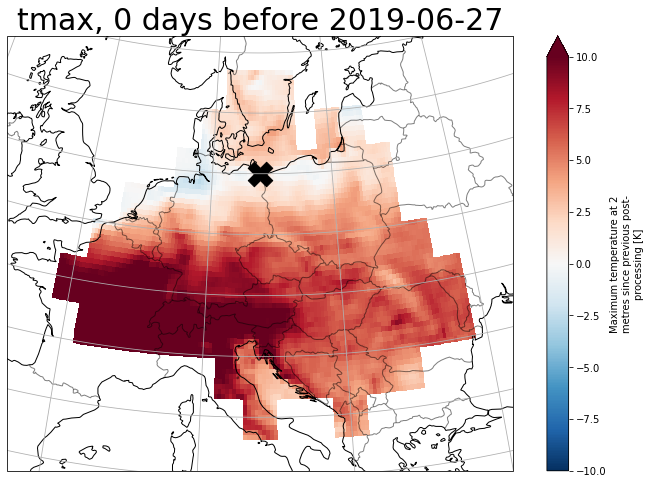

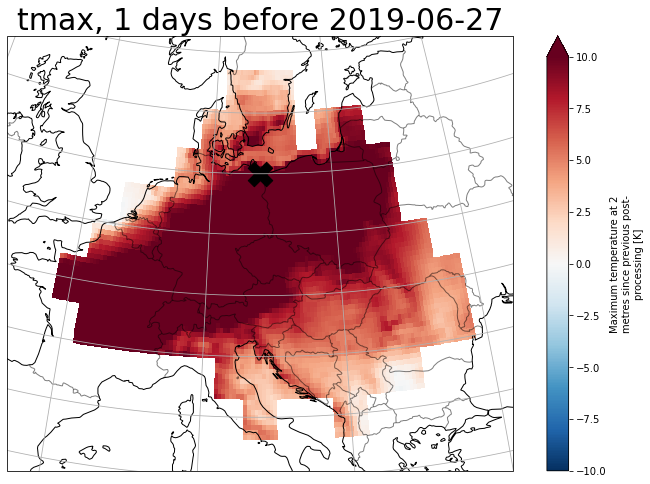

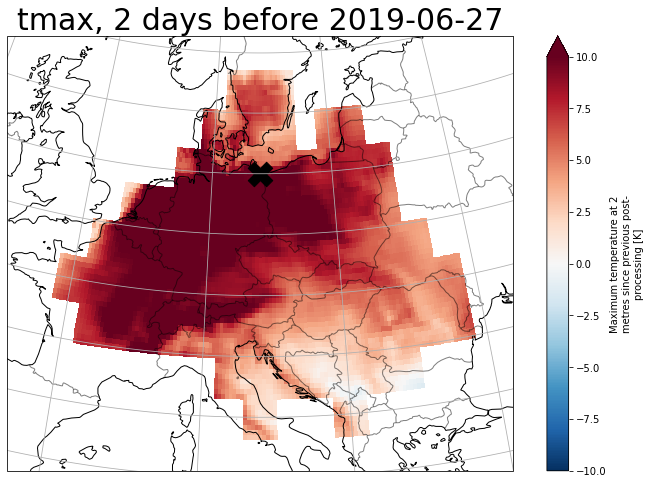

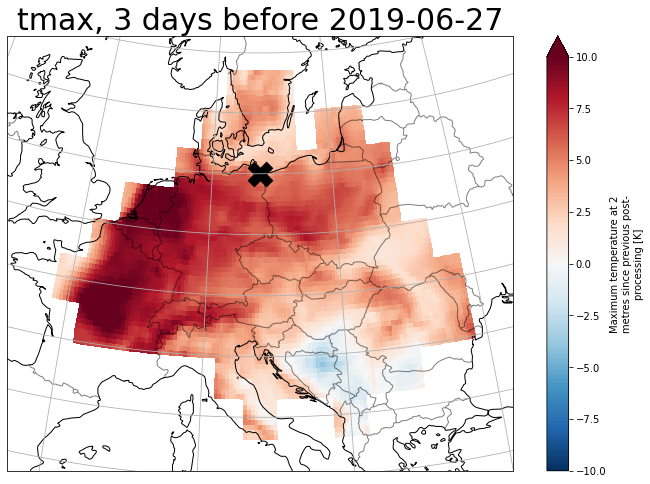

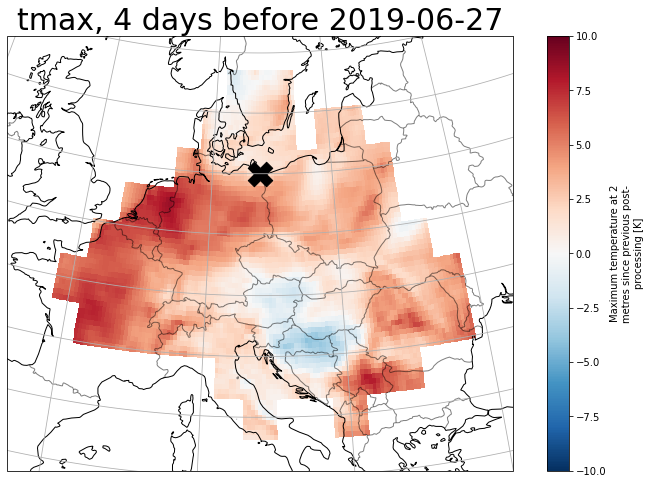

...

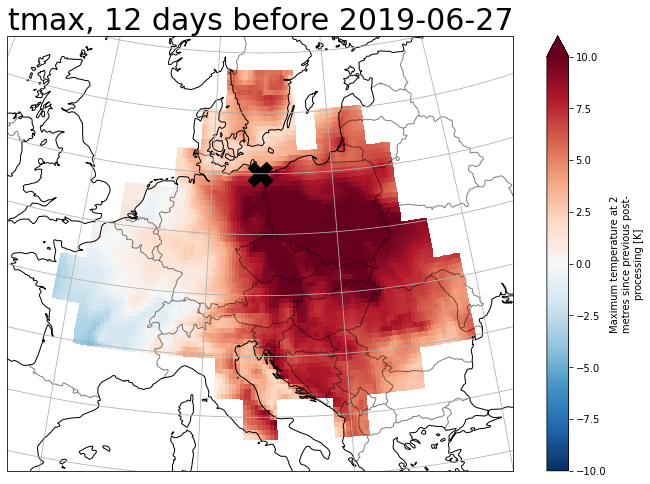

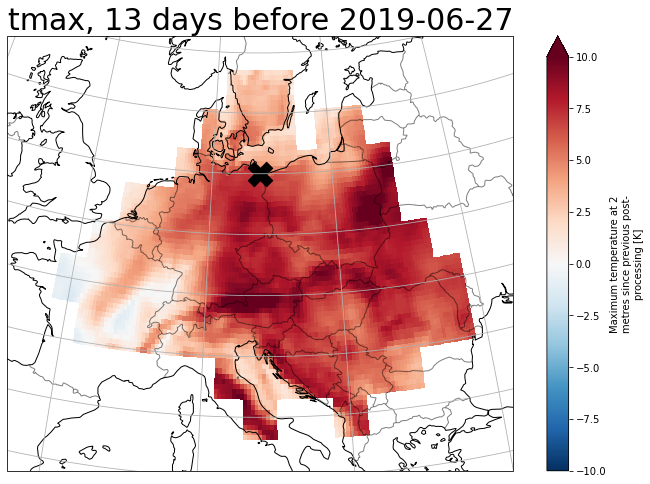

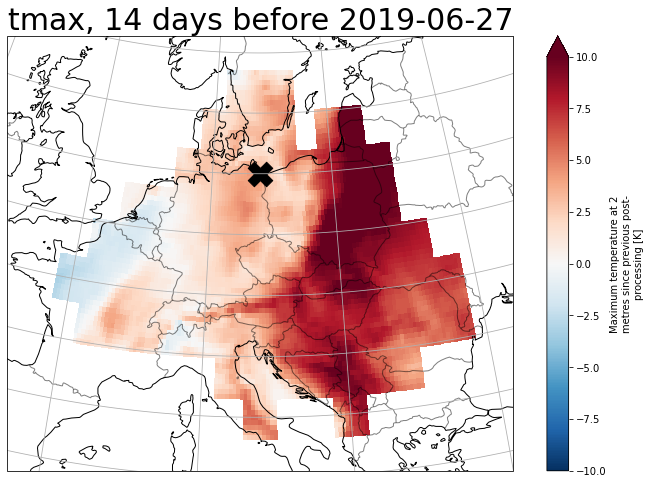

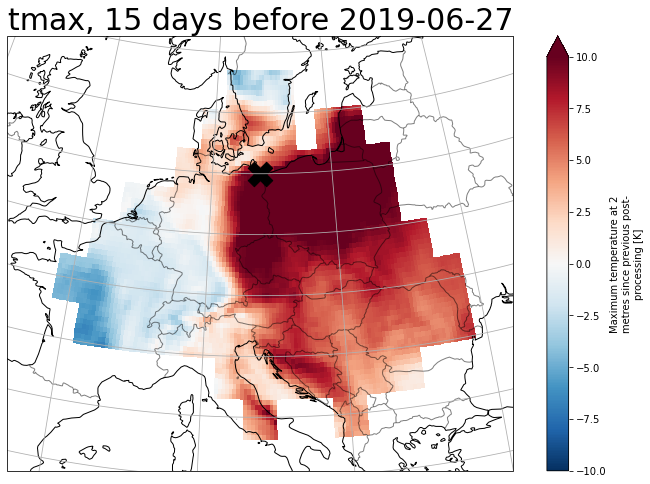

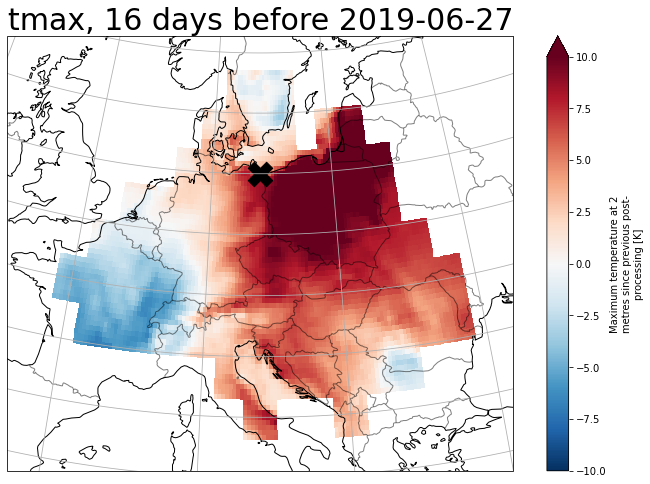

In [19]:
clint.set_maps_lag (xrdf = maskedtx2019, targetdate_ts = date2019_ts, drivers_row = drivers_row,
              proj = 'Orthographic', fig_height=8, fig_width=12)

#### Series of cluster centre

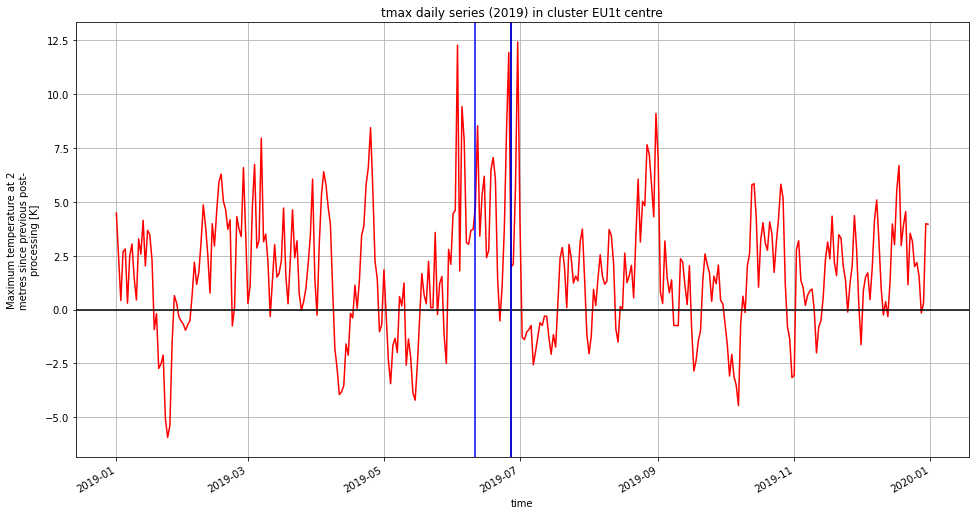

In [16]:
clint.daily_series_w_lags(tx2019, drivers_row, date2019_ts, plotdir)


### 2019, tmax. North Atlantic temperature 30 to 41 days before

In [17]:
### North Atlantic temperature 30 to 41 days before

drivers_row = drivers_sub.iloc[1]


In [18]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedtx2019 = clint.mask_xr_w_df(tx2019, submask)

#### Maps

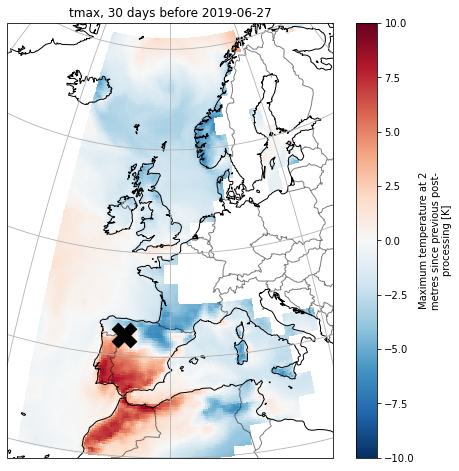

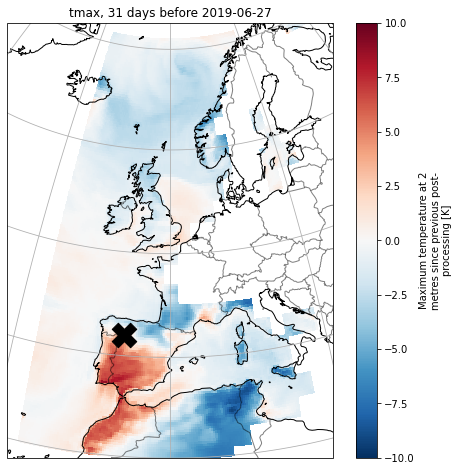

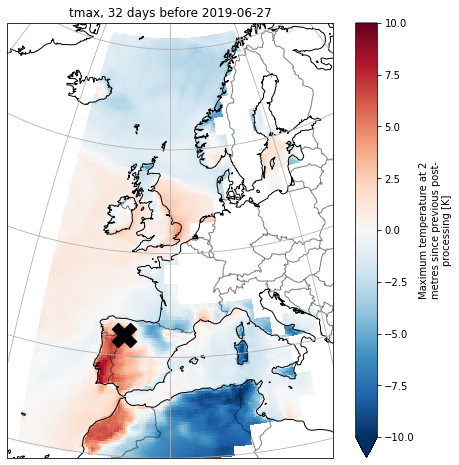

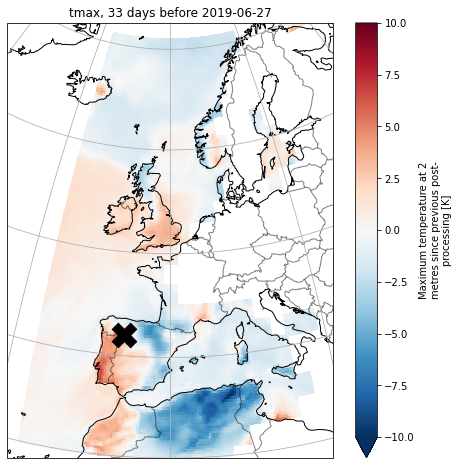

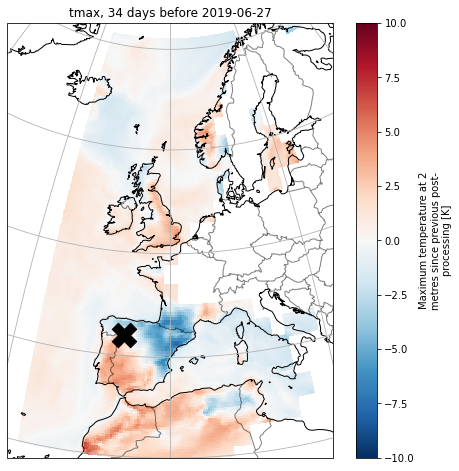

...

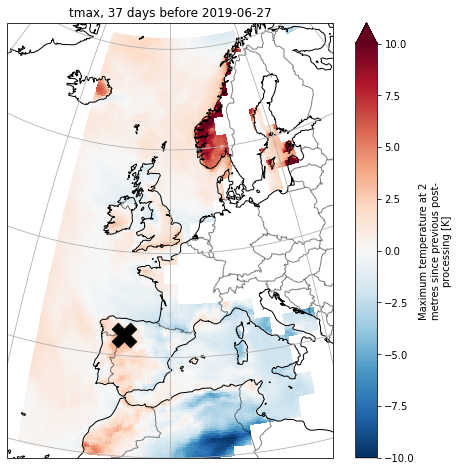

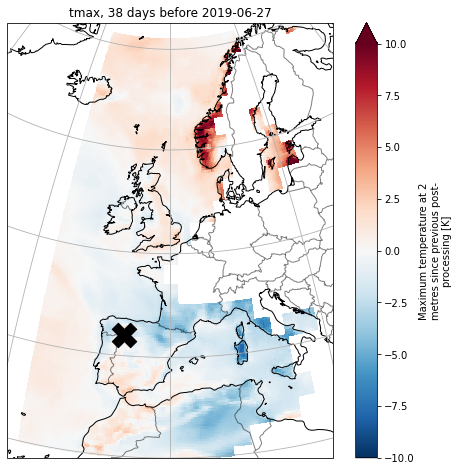

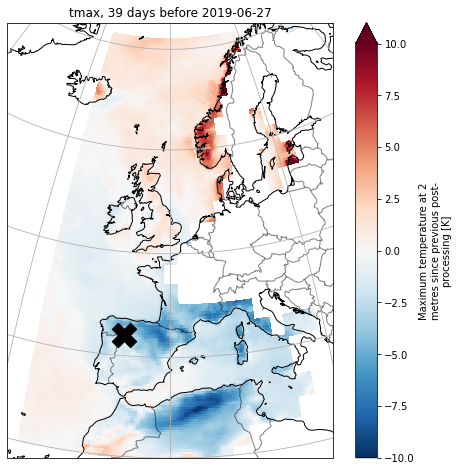

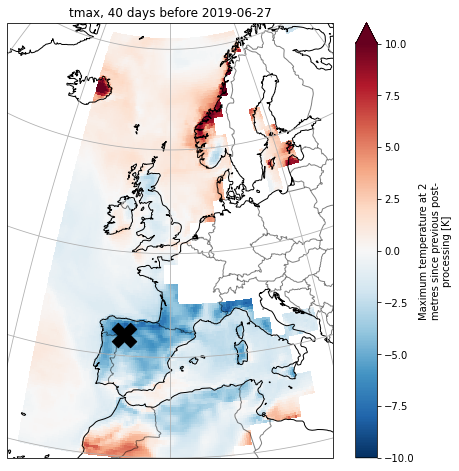

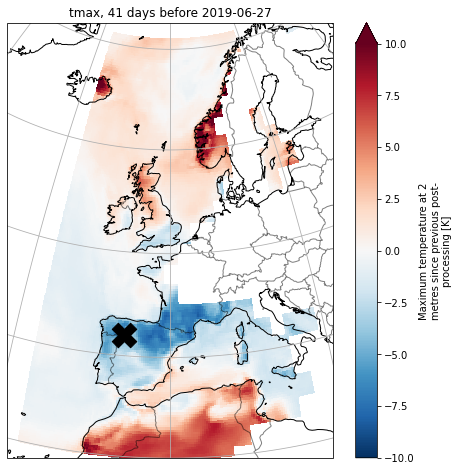

In [19]:
importlib.reload(clint)
clint.set_maps_lag (xrdf = maskedtx2019, targetdate_ts = date2019_ts, drivers_row = drivers_row, 
              proj = 'Orthographic',fig_width=8, fig_height=8)

#### Series of cluster centre

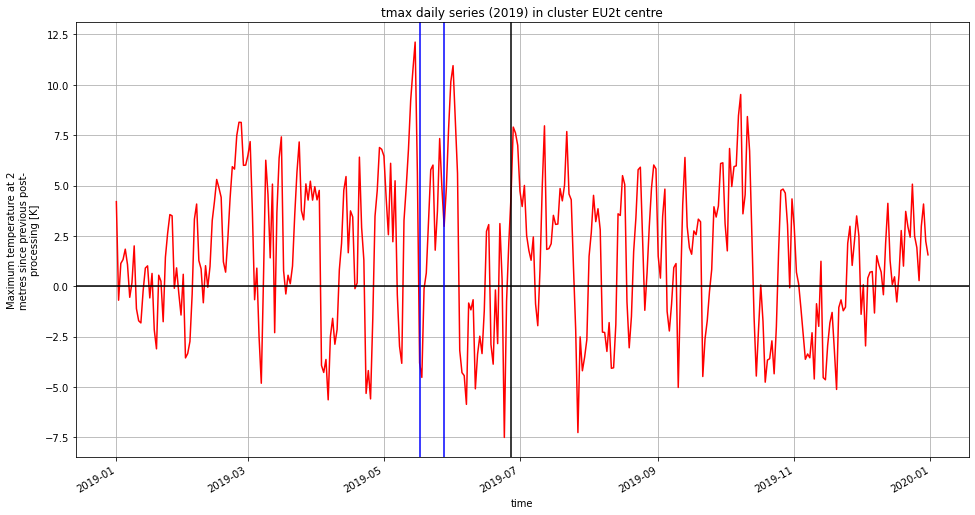

In [20]:
clint.daily_series_w_lags(tx2019, drivers_row, date2019_ts, plotdir)

# 2019: Mean Sea Level Pressure

In [21]:
### Lags for drivers
drivers = pd.read_csv('./metadata/drivers.csv')

In [22]:
### Set parameters

var='mslp'
drivers_sub = drivers.loc[drivers['var'] == var]
y = 2019

In [23]:
### ERA5 Temperature 2019

mslp2019 = xr.open_dataset(f'{modeldir}/era5_{var}_dailyanom_{y}_cropped.nc')
mslp2019['msl'] = mslp2019.msl/100

### 2019, mslp. Mediterranean 0 to 8 days before 

In [24]:
### Mediterranean 0 to 8 days before

drivers_row = drivers_sub.iloc[0]

In [25]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedmslp2019 = clint.mask_xr_w_df(mslp2019, submask)

#### Maps

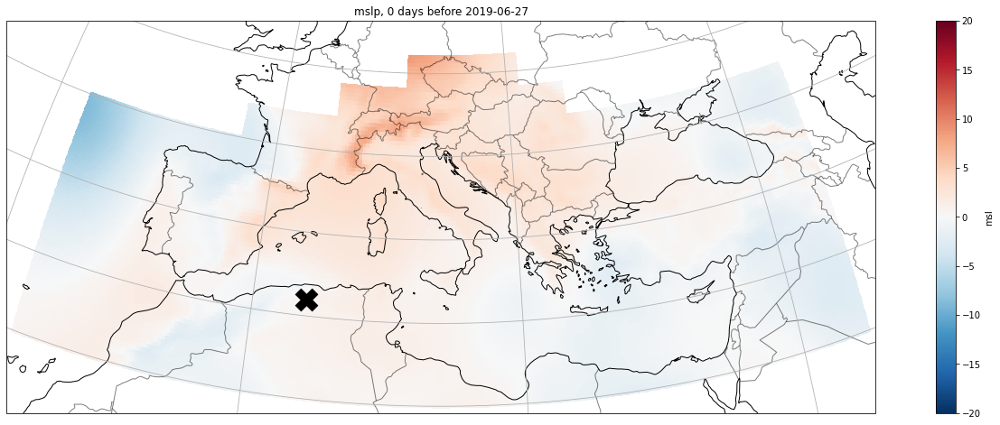

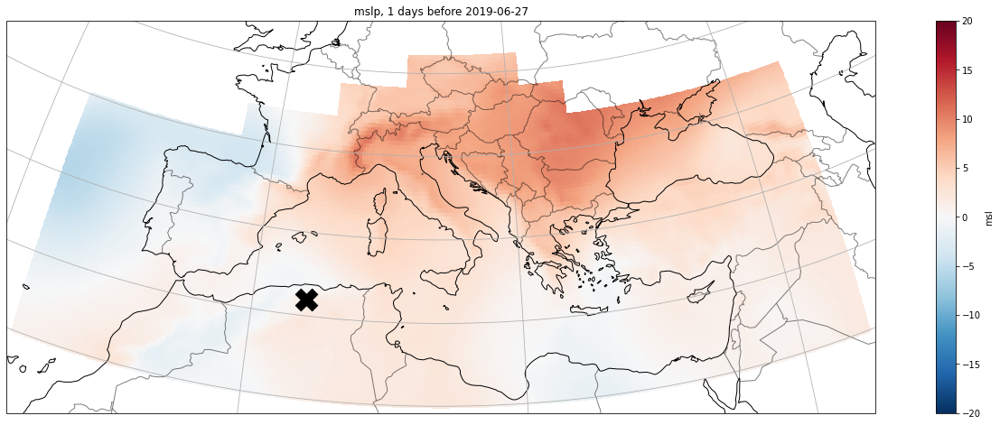

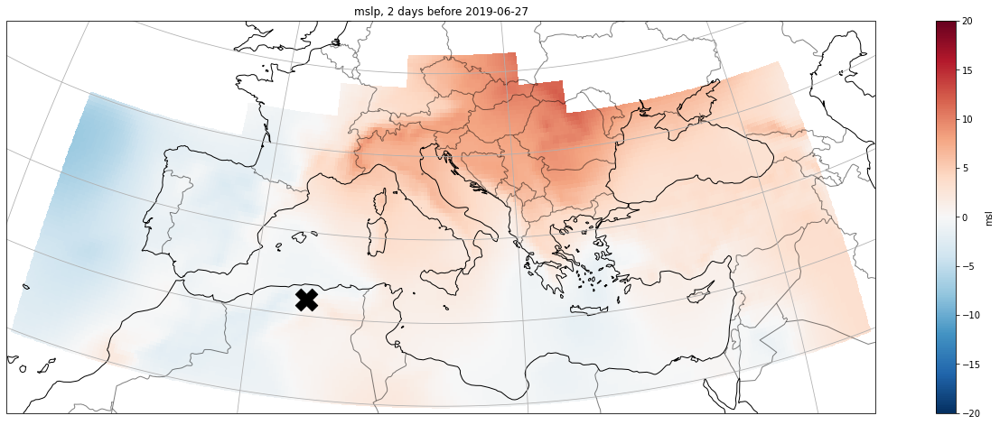

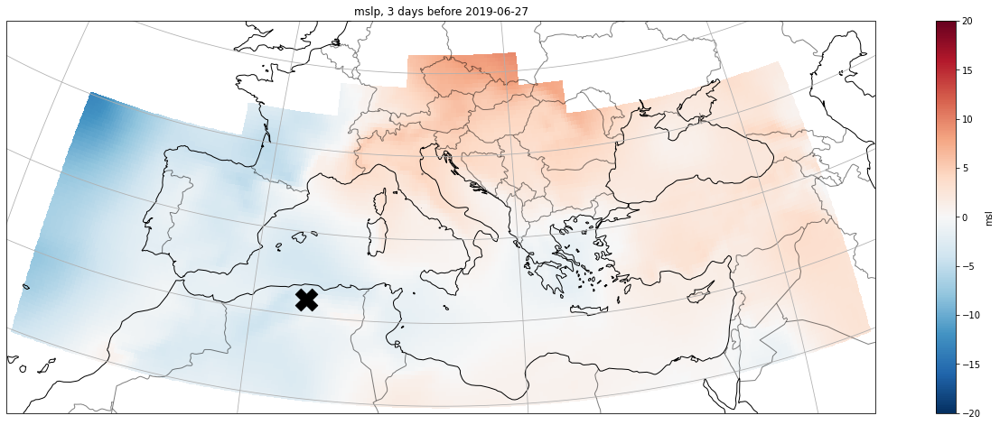

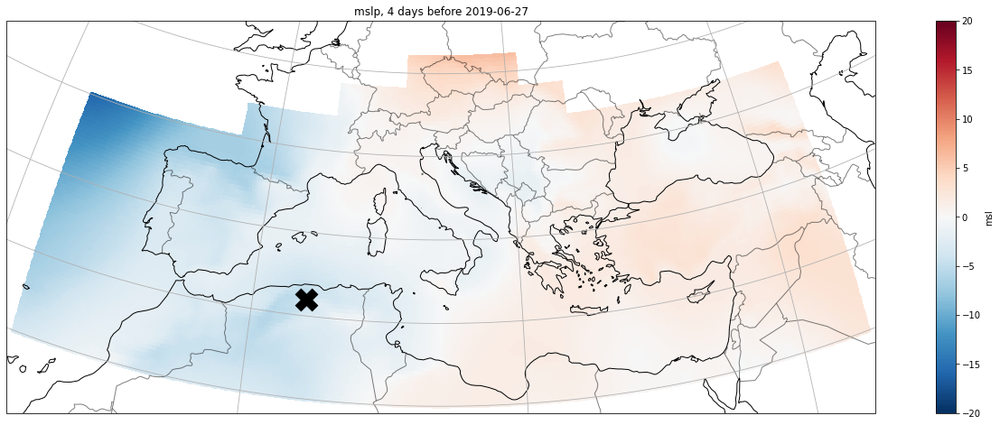

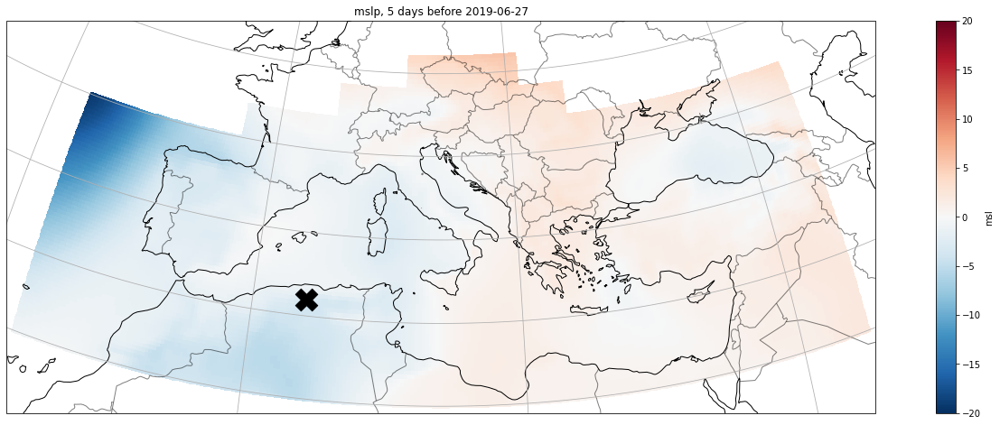

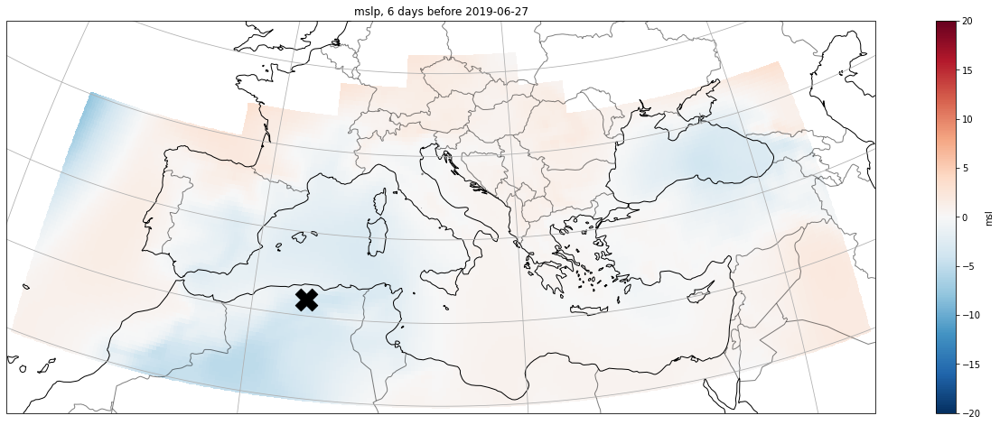

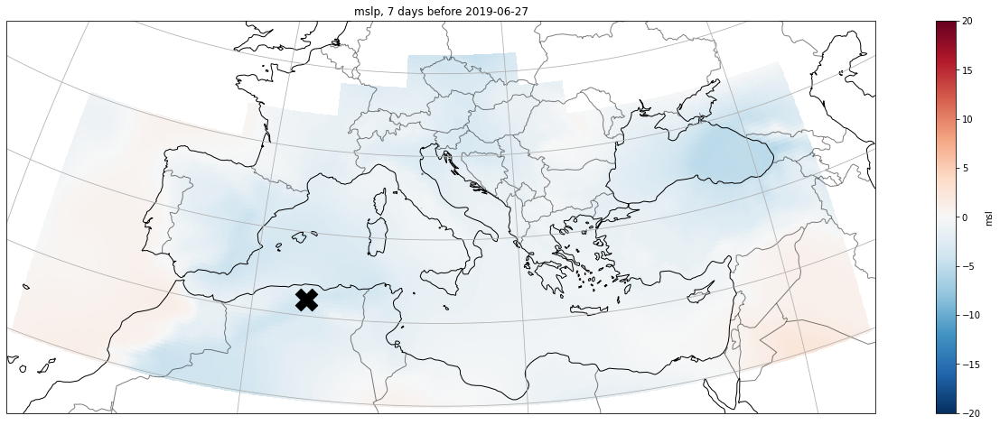

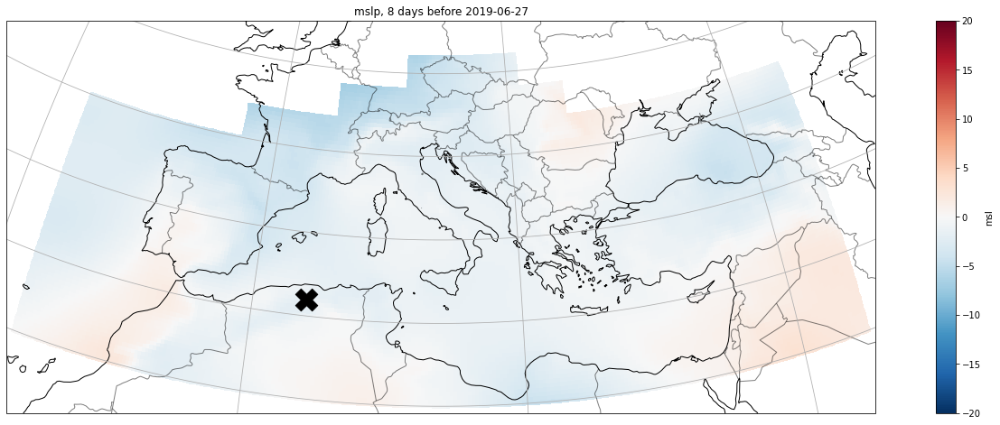

In [26]:
clint.set_maps_lag (xrdf = maskedmslp2019, targetdate_ts = date2019_ts, drivers_row = drivers_row, 
              fig_width = 24, fig_height = 8, vmin = 'drivers', vmax = 'drivers',
              proj = 'Orthographic')

#### Series of cluster centre

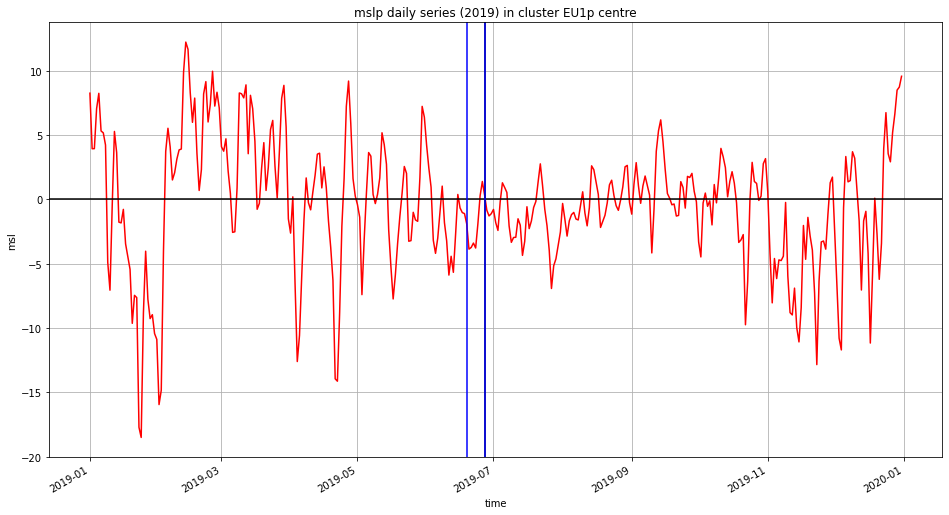

In [27]:
importlib.reload(clint)
clint.daily_series_w_lags(mslp2019, drivers_row, date2019_ts, plotdir)

In [28]:
drivers

,var,nc_var,test_nr,cluster,cluster_info,minlag,maxlag,cluster_centre_lon,cluster_centre_lat,cl_ortho_lon,...,cl_ext_W,cl_ext_E,cl_ext_S,cl_ext_N,clmask_test3,cl_nr,vmin,vmax,empty,meanlag
0,tmax,mx2t,3,EU1t,Central Europe,0,16,14.0,54.0,14.0,...,-2.0,30.0,38.0,60.0,labels7t2mEurope5.csv,1,-10.0,10.0,NaN,8
1,tmax,mx2t,3,EU2t,North Atlantic,30,41,-6.0,42.0,0.0,...,-18.0,18.0,28.0,72.0,labels7t2mEurope5.csv,2,-10.0,10.0,NaN,35
2,mslp,msl,3,EU1p,Mediterranean,0,8,4.0,36.0,14.0,...,-16.0,44.0,25.0,50.0,labels1mslpEurope5.csv,1,-20.0,20.0,NaN,4
3,mslp,msl,3,EU2p,Eastern Europe,70,86,32.0,54.0,29.0,...,12.0,46.0,44.0,63.0,labels1mslpEurope5.csv,2,-20.0,20.0,NaN,78
4,mslp,msl,3,WO2p,Greenland,40,61,-78.0,80.0,-56.0,...,-85.0,-20.0,48.0,90.0,labels2mslpWorld5.csv,2,-20.0,20.0,NaN,50
5,sm,sm,3,EU1sm,Eastern Europe,0,26,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,13
6,sic,sic,3,AC1sic,North Atlantic and North Pacific,30,51,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,40


### 2019, mslp. Eastern Europe 70 to 86 days before 

In [29]:
### Eastern Europe 70 to 86 days before

drivers_row = drivers_sub.iloc[1]


#### Maps

In [30]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedmslp2019 = clint.mask_xr_w_df(mslp2019, submask)

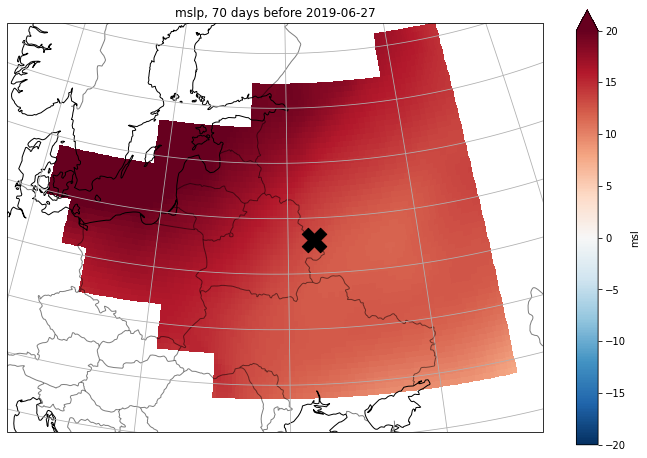

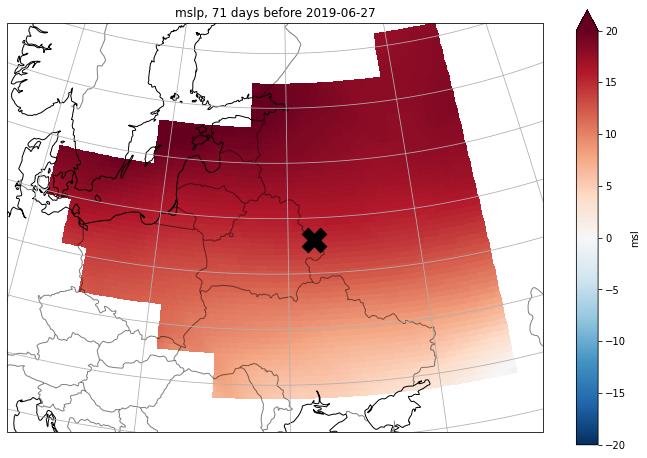

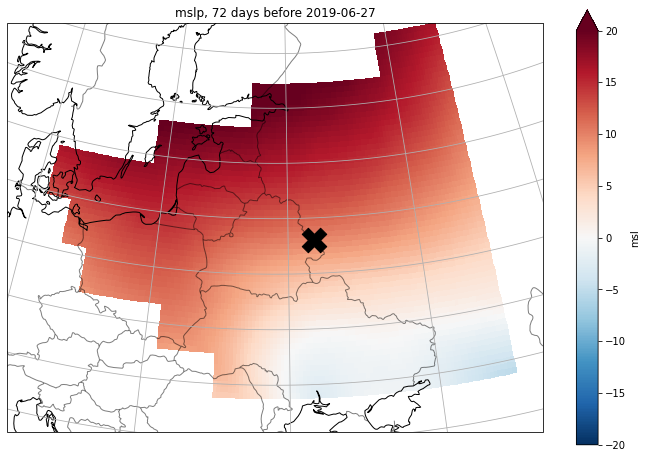

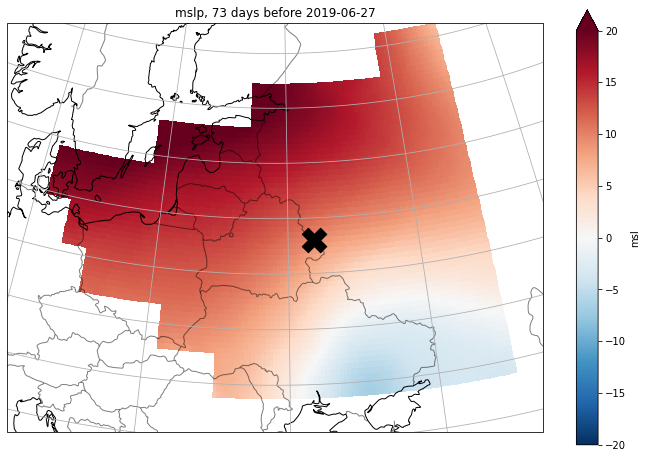

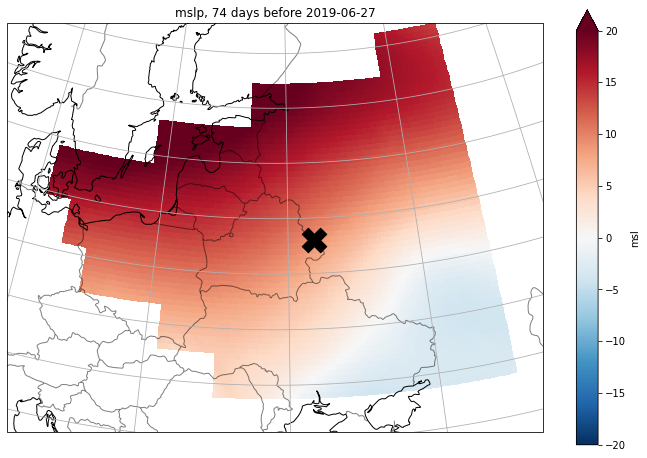

...

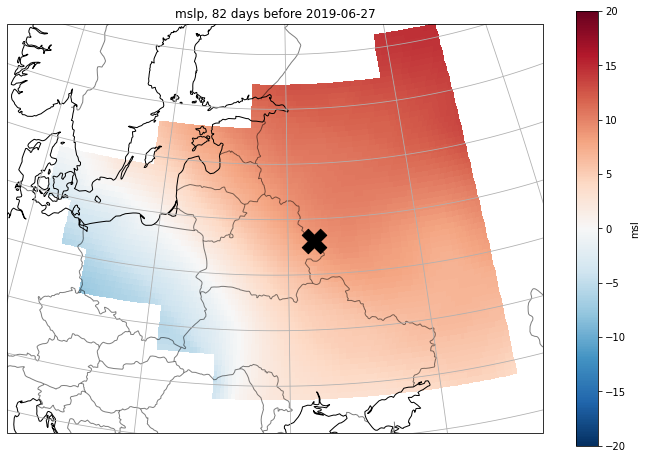

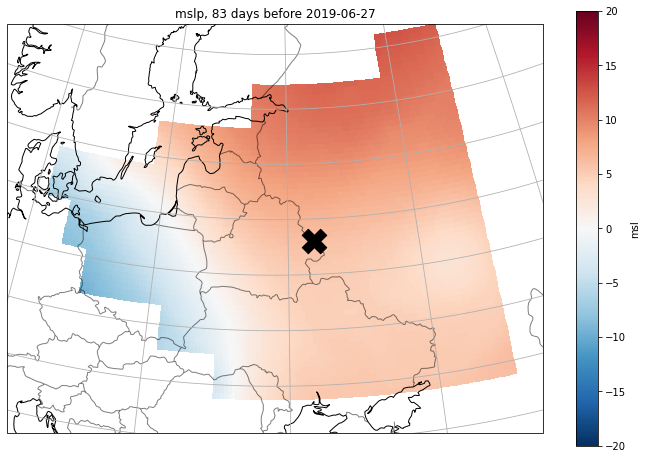

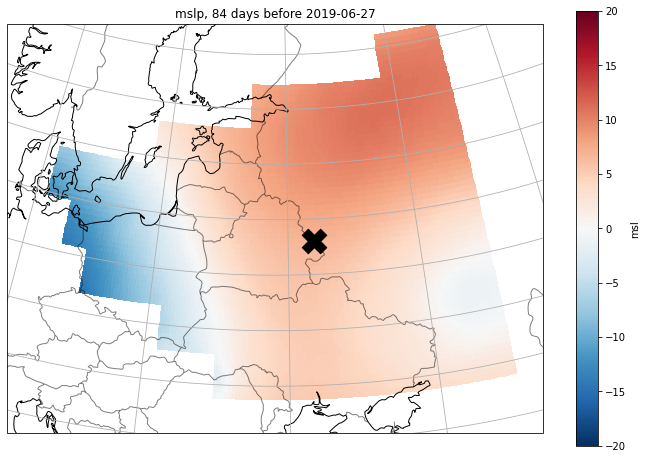

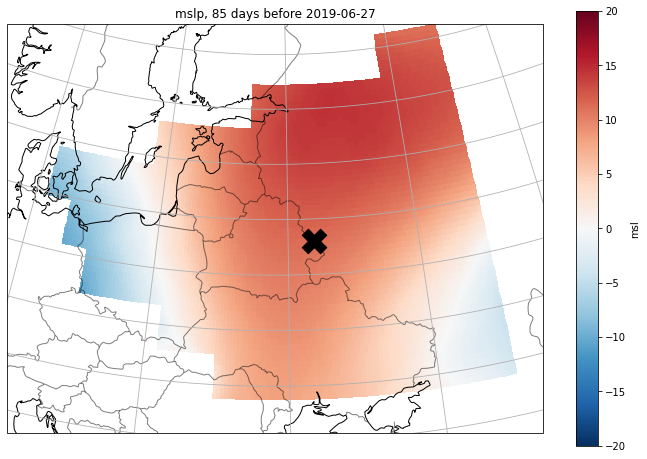

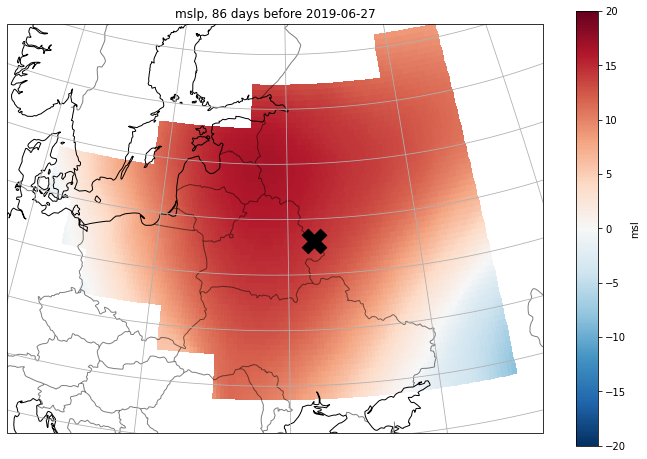

In [31]:
clint.set_maps_lag (xrdf = maskedmslp2019, targetdate_ts = date2019_ts, drivers_row = drivers_row, fig_width=12,
              proj = 'Orthographic')

#### Series of cluster centre

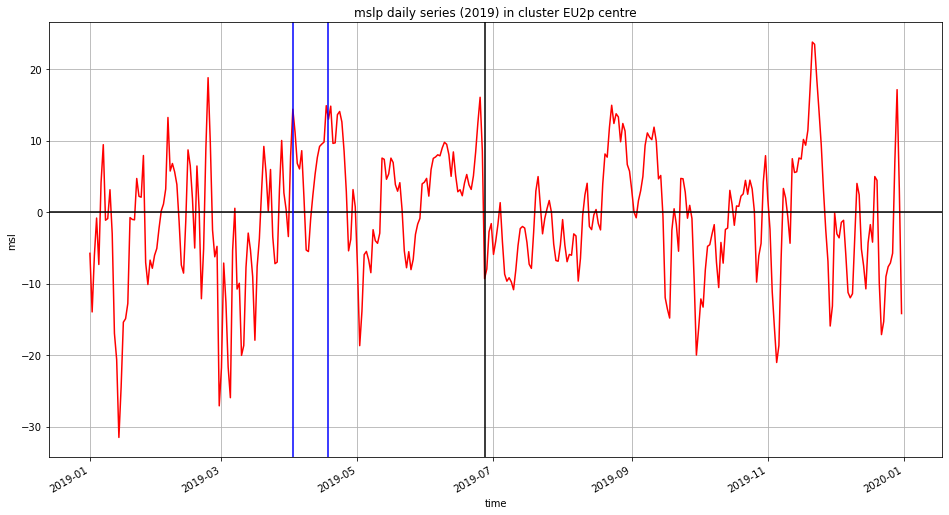

In [32]:
clint.daily_series_w_lags(mslp2019, drivers_row, date2019_ts, plotdir)

### 2019, mslp. Greenland 40 to 60 days before 

In [33]:
### Lags for drivers
drivers = pd.read_csv('./metadata/drivers.csv')

In [34]:
### Set parameters

var='mslp'
drivers_sub = drivers.loc[drivers['var'] == var]
y = 2019

In [35]:
### Greenland 40 to 60 days before

drivers_row = drivers_sub.iloc[2]


In [36]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedmslp2019 = clint.mask_xr_w_df(mslp2019, submask)

#### Maps

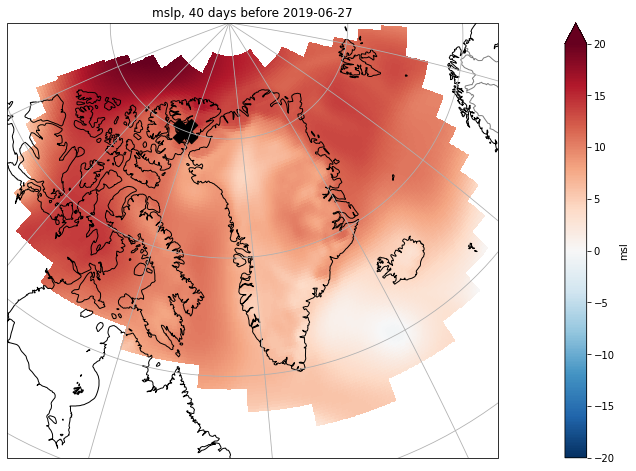

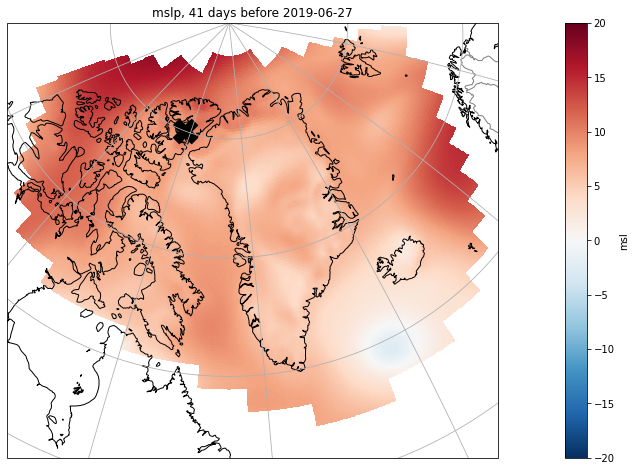

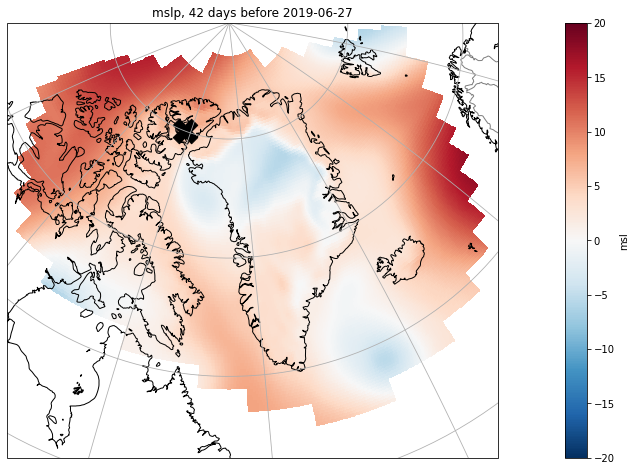

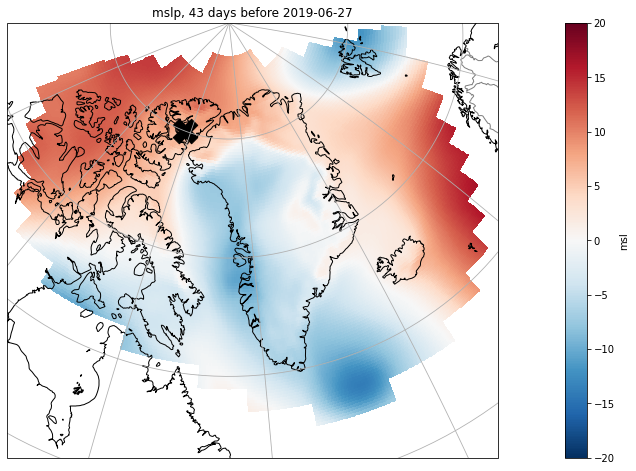

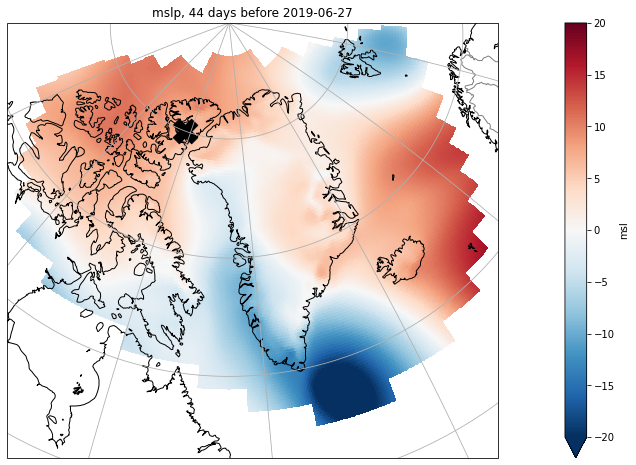

...

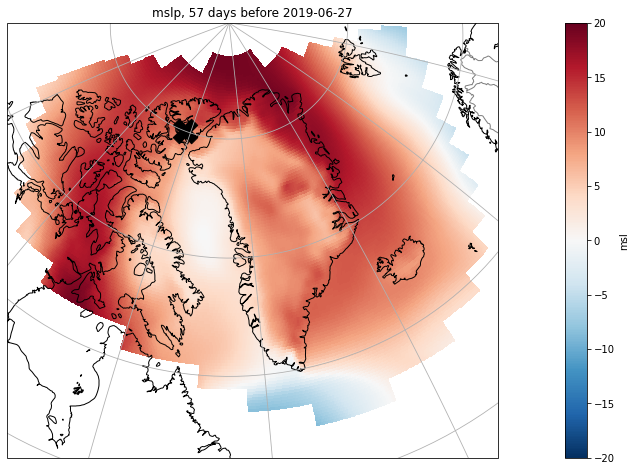

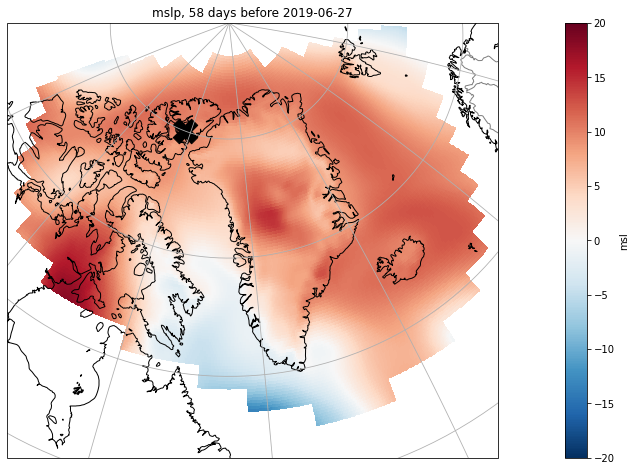

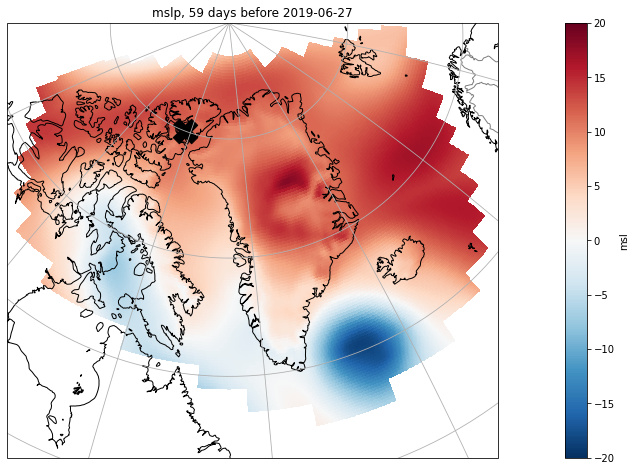

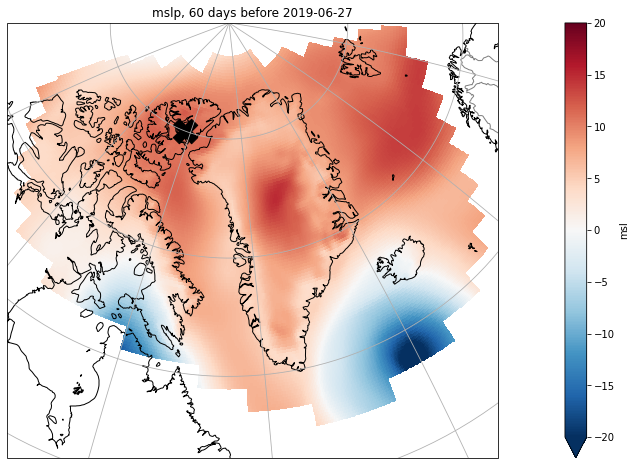

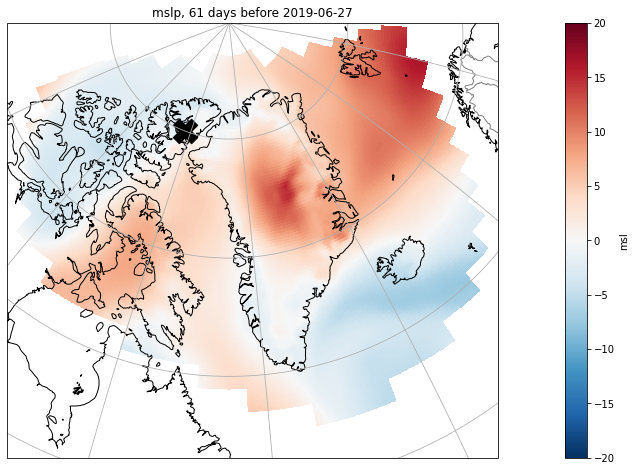

In [37]:
clint.set_maps_lag (xrdf = maskedmslp2019, targetdate_ts = date2019_ts, drivers_row = drivers_row,
              fig_width = 24,
              proj = 'Orthographic')

In [38]:
# minlag = int(drivers_row['minlag'])
# maxlag = int(drivers_row['maxlag'])
# # Determine extremes of the date range considered, in the netcdf every day has 12:00 as hour
# mintime_ts = targetdate_ts - pd.DateOffset(days = maxlag) + pd.DateOffset(hours = 12)
# maxtime_ts = targetdate_ts - pd.DateOffset(days = minlag) + pd.DateOffset(hours = 12)

# plt.rcParams['figure.figsize'] = [18,6]
# ax = plt.axes(projection=ccrs.LambertConformal(-40,45))
# ax.set_global()

# mslp2019.sel(time=mintime_ts).msl.plot(ax=ax, transform=ccrs.PlateCarree())
# ax.coastlines()
# ax.set_extent([-130, 45,1, 90])

#### Series of cluster centre

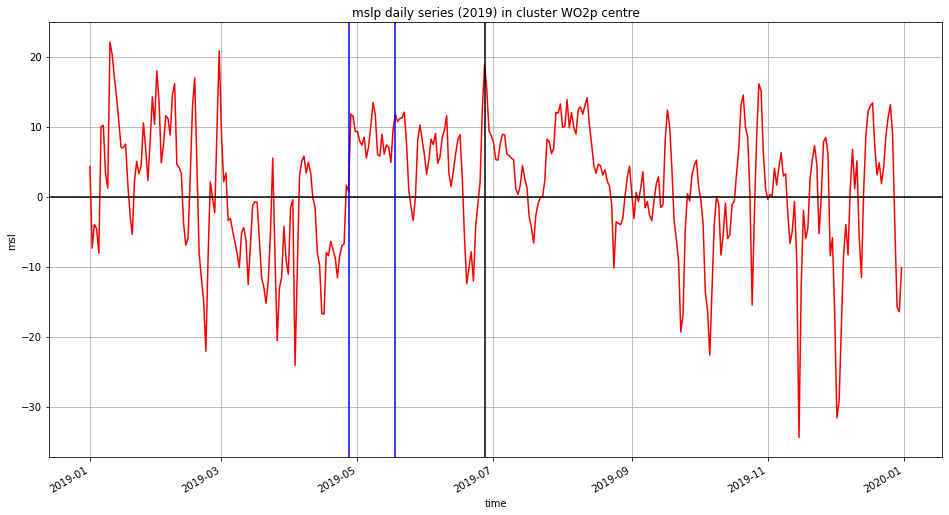

In [39]:
clint.daily_series_w_lags(mslp2019, drivers_row, date2019_ts, plotdir)

# 2022: Maximum temperature

In [40]:
### Maximum temperature 2022

var='tmax'
drivers_sub = drivers.loc[drivers['var'] == var]
y = 2022

In [41]:
### ERA5 Temperature 2022

tx2022 = xr.open_dataset(f'{modeldir}/era5_{var}_dailyanom_{y}_cropped.nc')
#tx2022['mx2t'] = tx2022.mx2t - 273.15

In [42]:
### Identify 2022 heat wave
row_maxHWMI = lchw.loc[lchw.loc[(lchw.year == y) & (lchw.month >= 6),'Valle_HWintensity'].idxmax()]

date2022_dt = dt.strptime(row_maxHWMI.name,"%Y-%m-%d")
date2022_ts = pd.to_datetime(date2022_dt)


### 2022, tmax. Central Europe 0 to 16 days before 

In [43]:
### Central Europe 0 to 16 days before

drivers_row = drivers_sub.iloc[0]

In [44]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedtx2022 = clint.mask_xr_w_df(tx2022, submask)

#### Maps

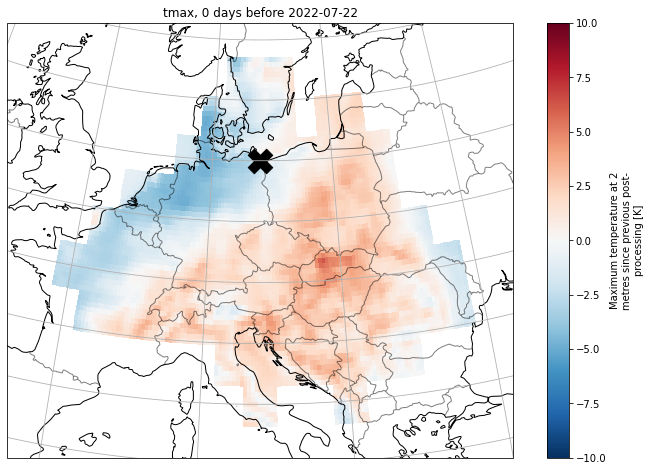

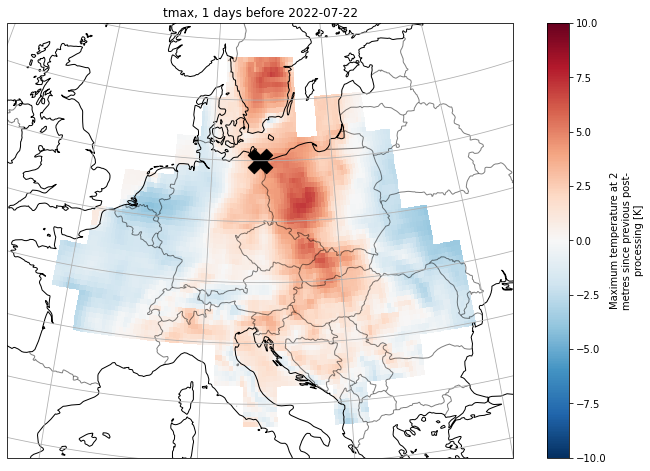

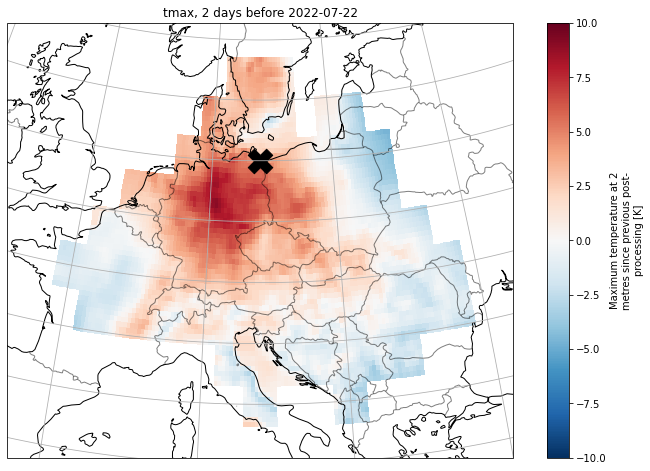

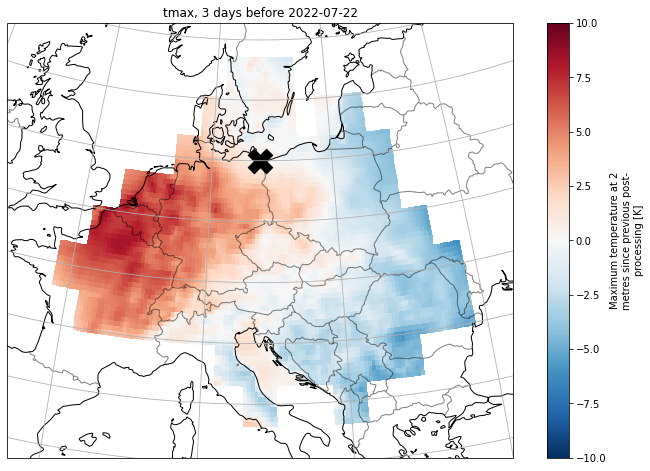

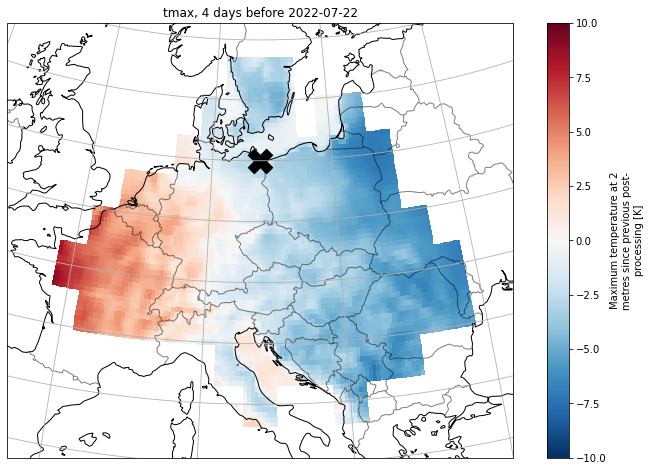

...

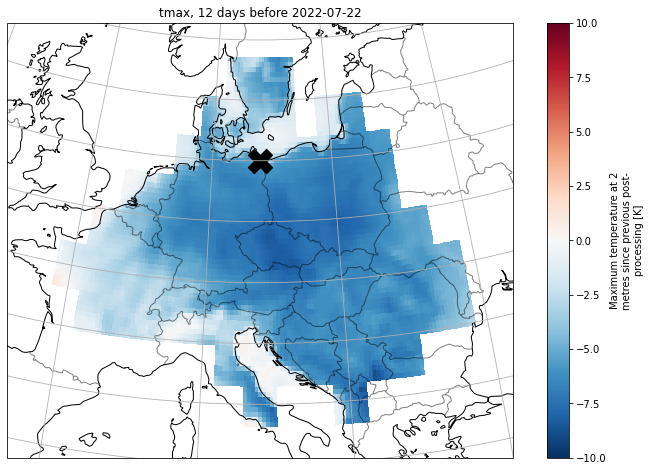

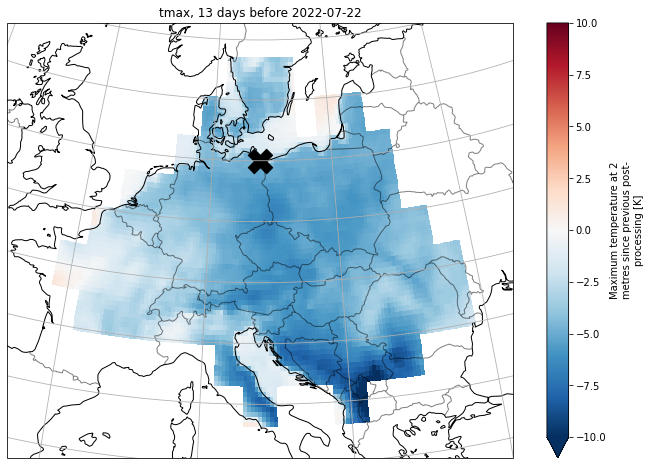

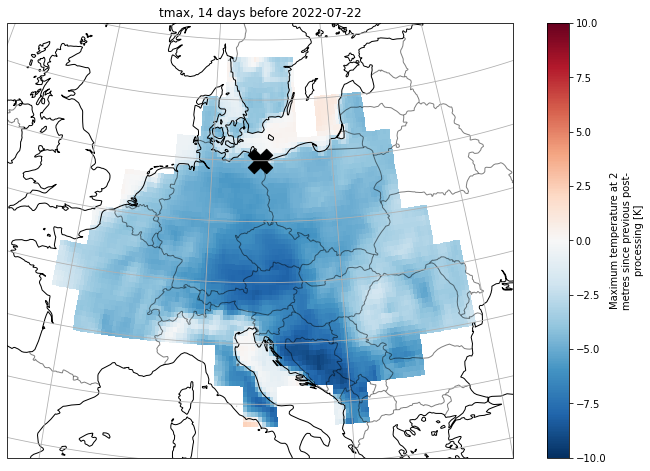

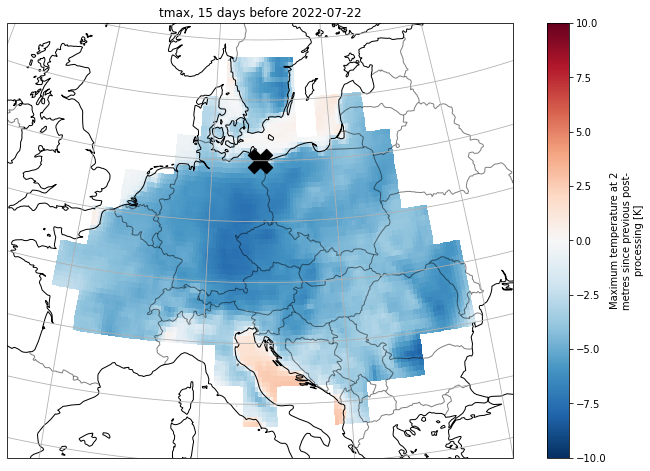

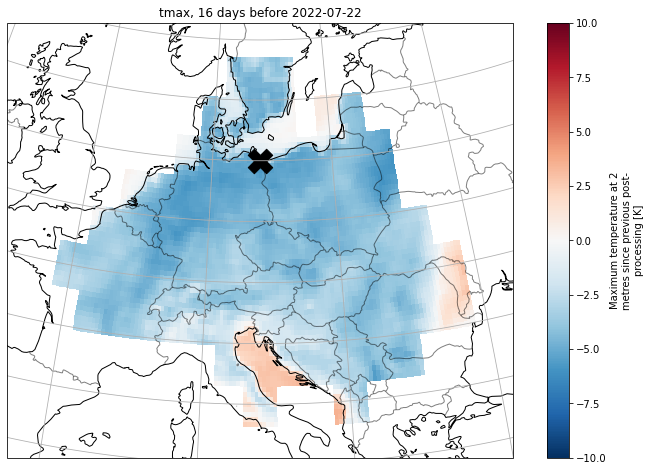

In [45]:
clint.set_maps_lag (xrdf = maskedtx2022, targetdate_ts = date2022_ts, drivers_row = drivers_row, 
              proj = 'Orthographic',fig_width=12)

#### Series of cluster centre

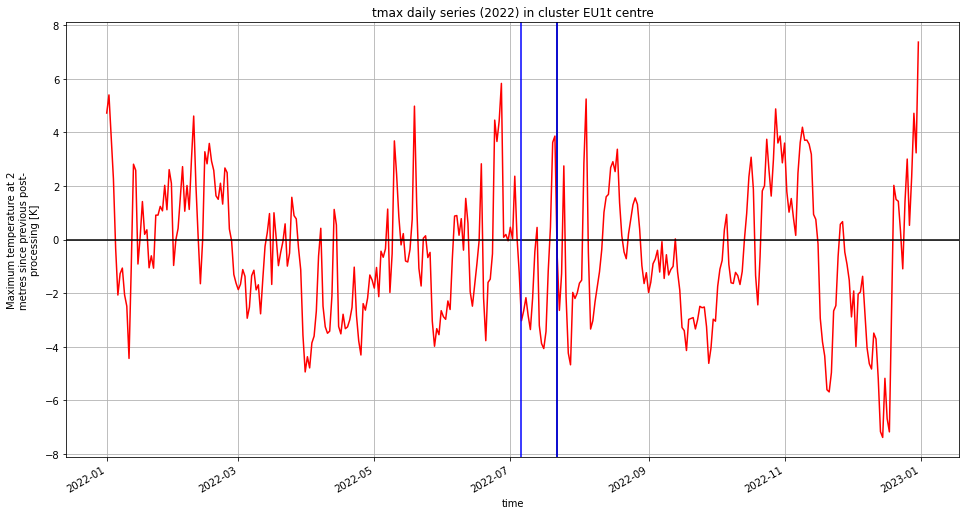

In [46]:
clint.daily_series_w_lags(tx2022, drivers_row, date2022_ts, plotdir)

### 2022, tmax. North Atlantic temperature 30 to 41 days before

In [47]:
### North Atlantic temperature 30 to 41 days before

drivers_row = drivers_sub.iloc[1]


In [48]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedtx2022 = clint.mask_xr_w_df(tx2022, submask)

#### Maps

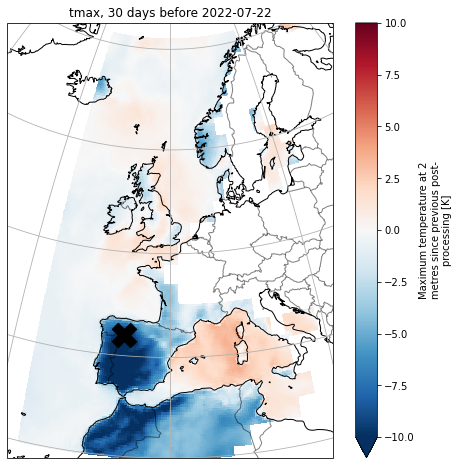

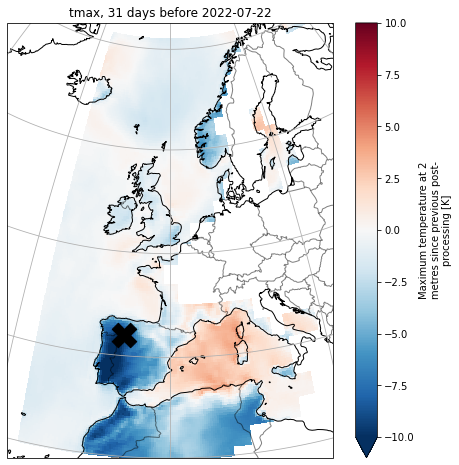

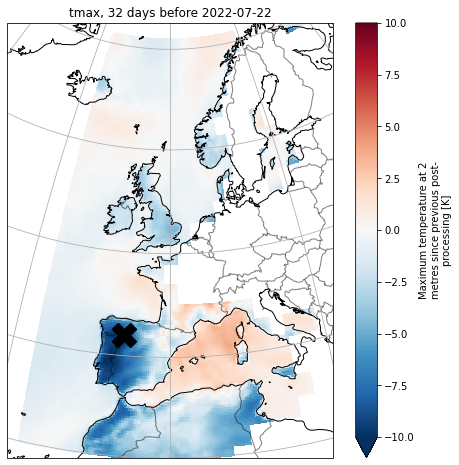

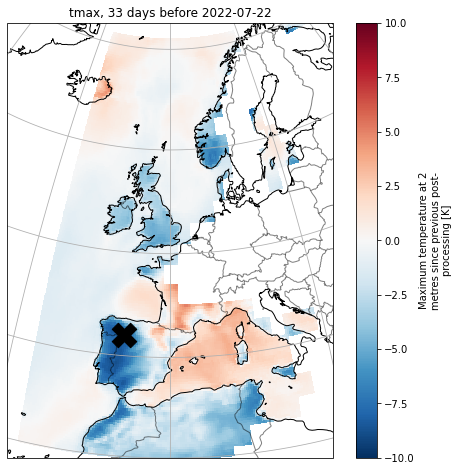

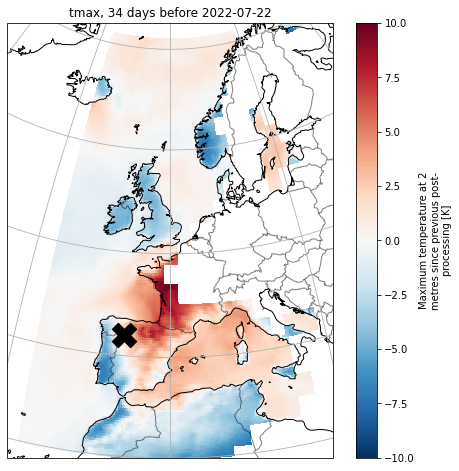

...

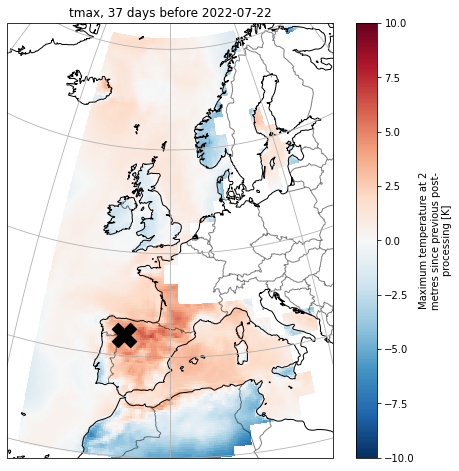

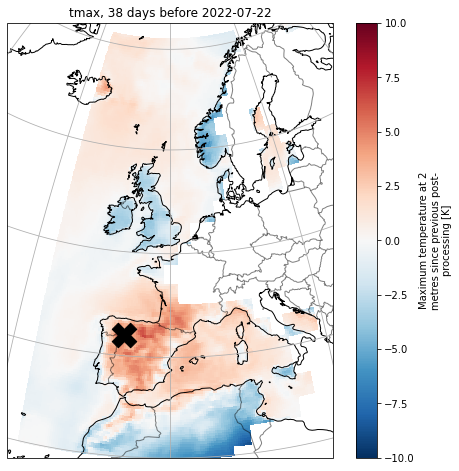

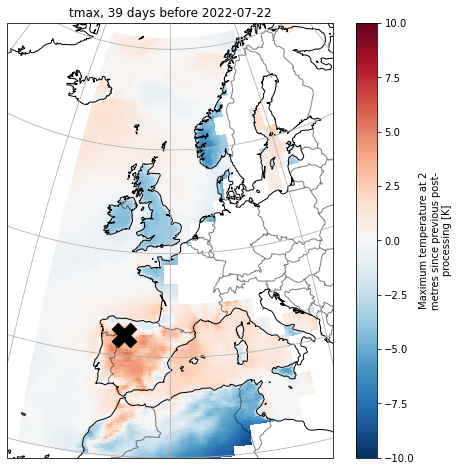

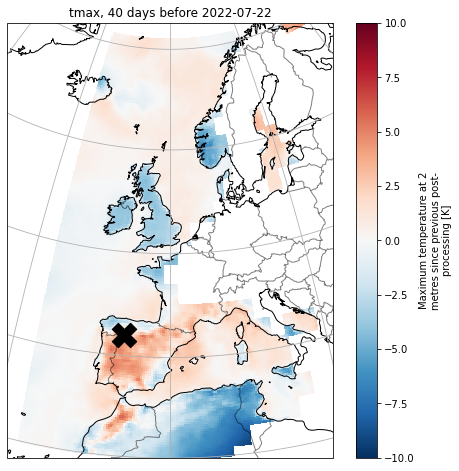

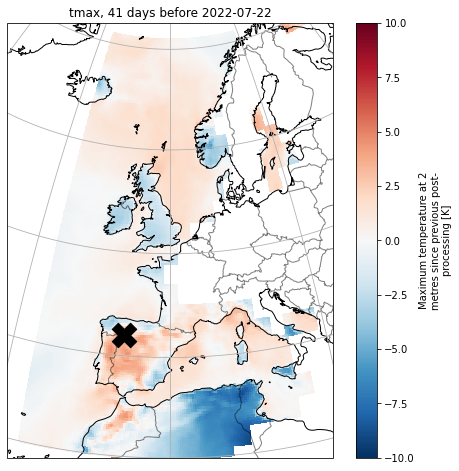

In [49]:
clint.set_maps_lag (xrdf = maskedtx2022, targetdate_ts = date2022_ts, drivers_row = drivers_row, 
              proj = 'Orthographic',fig_width=8)

#### Series of cluster centre

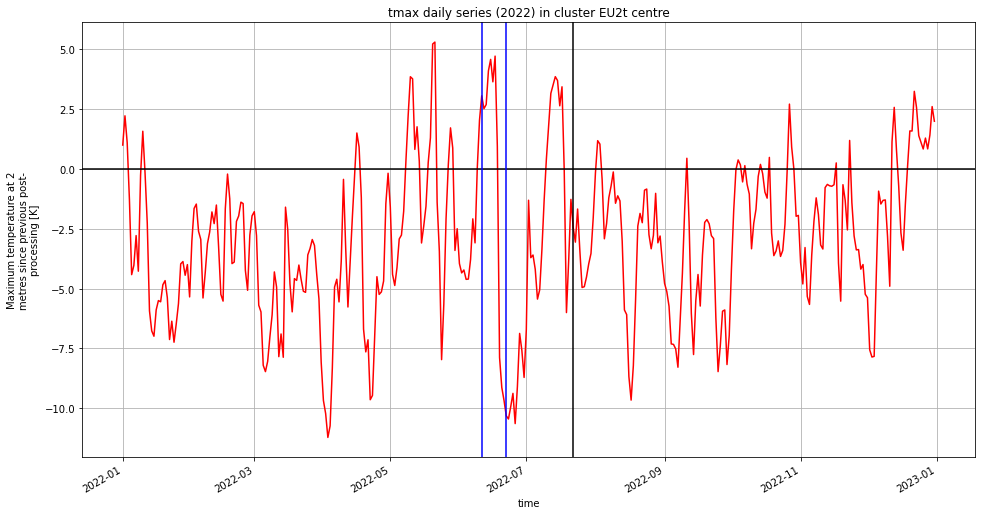

In [50]:
clint.daily_series_w_lags(tx2022, drivers_row, date2022_ts, plotdir)

# 2022: Mean Sea Level Pressure

In [51]:
### Set parameters

var='mslp'
drivers_sub = drivers.loc[drivers['var'] == var]
y = 2022

In [52]:
### ERA5 Temperature 2022

mslp2022 = xr.open_dataset(f'{modeldir}/era5_{var}_dailyanom_{y}_cropped.nc')
mslp2022['msl'] = mslp2022.msl/100

### 2022, mslp. Mediterranean 0 to 8 days before 

In [53]:
### Mediterranean 0 to 8 days before

drivers_row = drivers_sub.iloc[0]

In [54]:
drivers_row

var                                     mslp
nc_var                                   msl
test_nr                                    3
cluster                                 EU1p
cluster_info                   Mediterranean
minlag                                     0
maxlag                                     8
cluster_centre_lon                       4.0
cluster_centre_lat                      36.0
cl_ortho_lon                            14.0
cl_ortho_lat                            40.0
cl_ext_W                               -16.0
cl_ext_E                                44.0
cl_ext_S                                25.0
cl_ext_N                                50.0
clmask_test3          labels1mslpEurope5.csv
cl_nr                                      1
vmin                                   -20.0
vmax                                    20.0
empty                                    NaN
meanlag                                    4
Name: 2, dtype: object

In [55]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedmslp2022 = clint.mask_xr_w_df(mslp2022, submask)

#### Maps

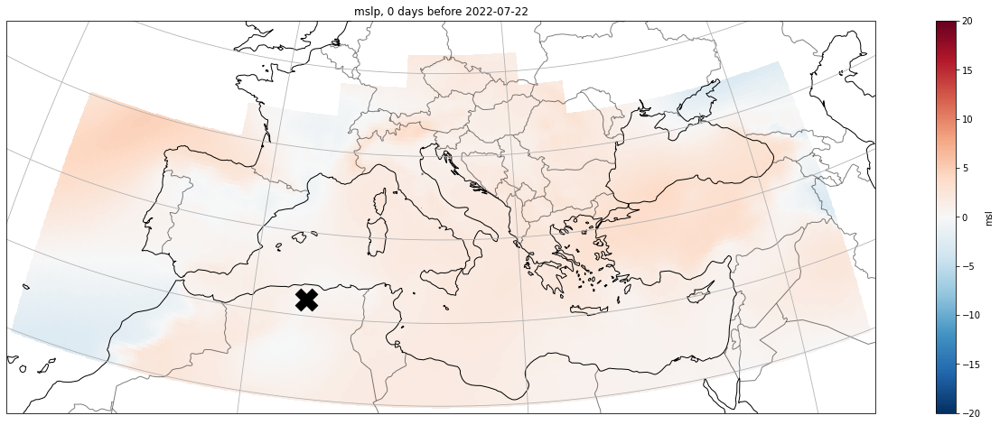

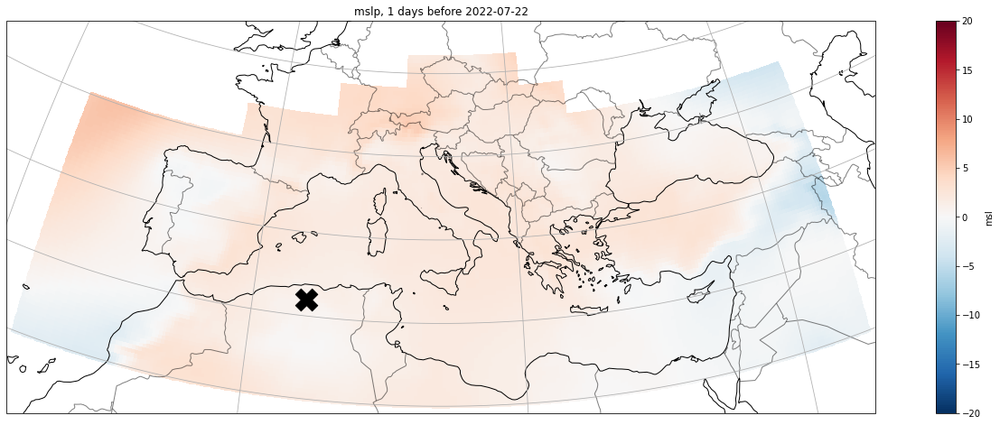

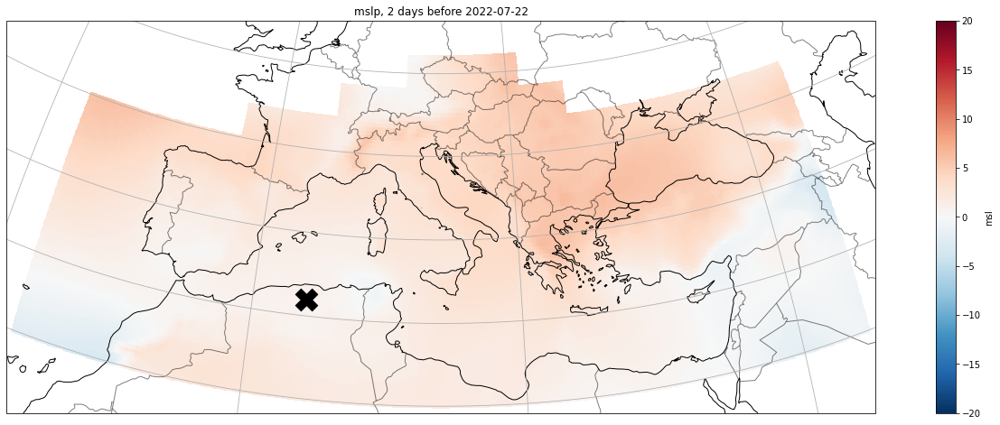

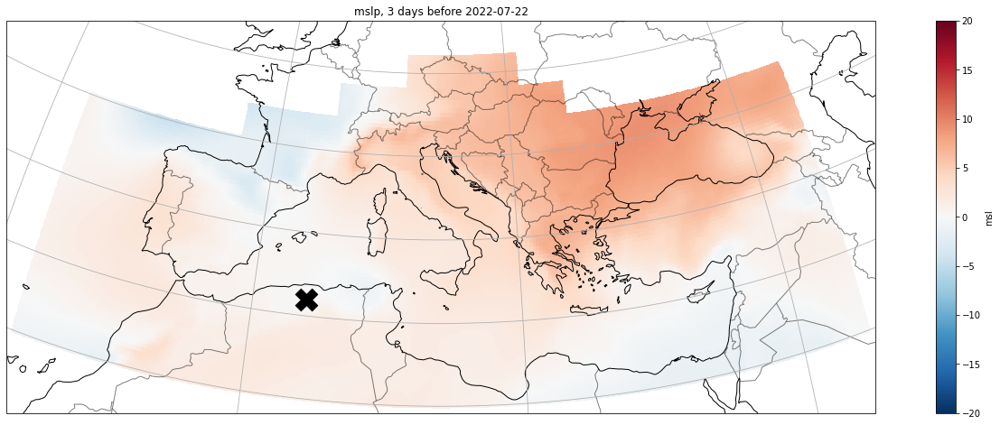

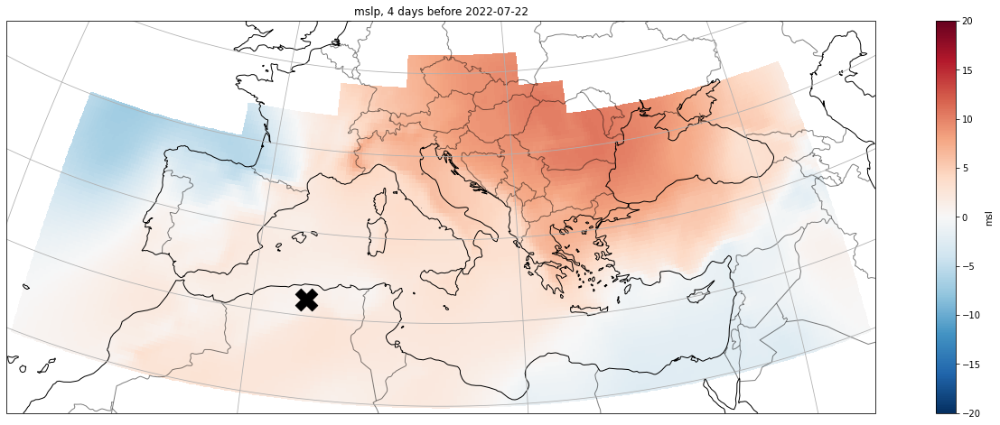

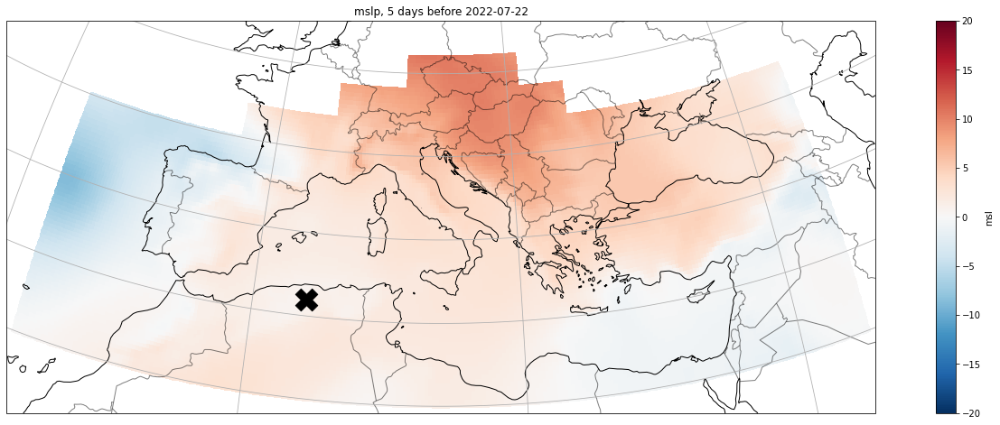

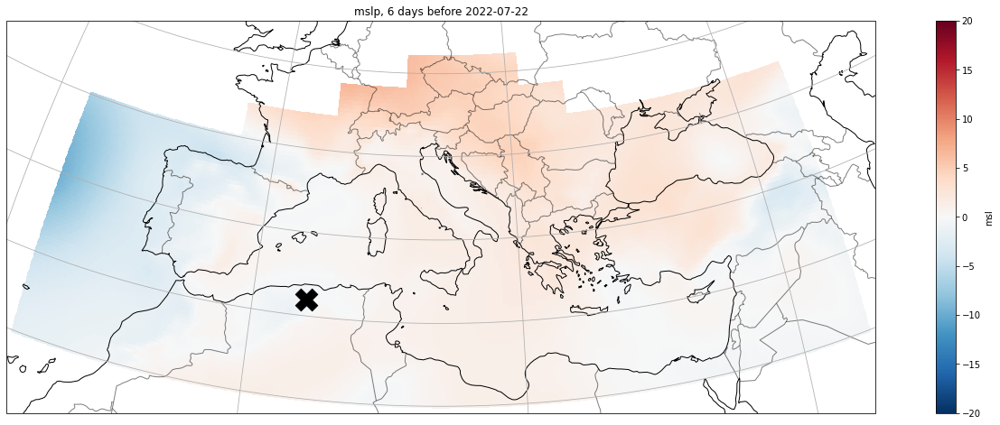

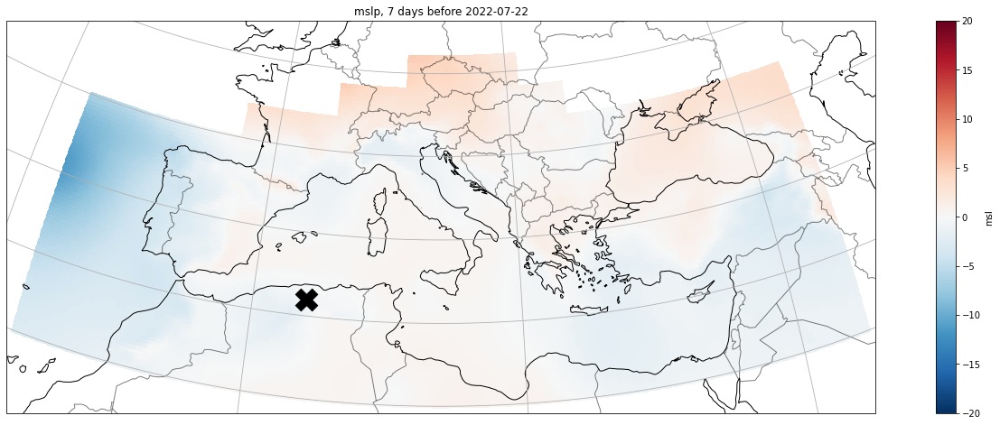

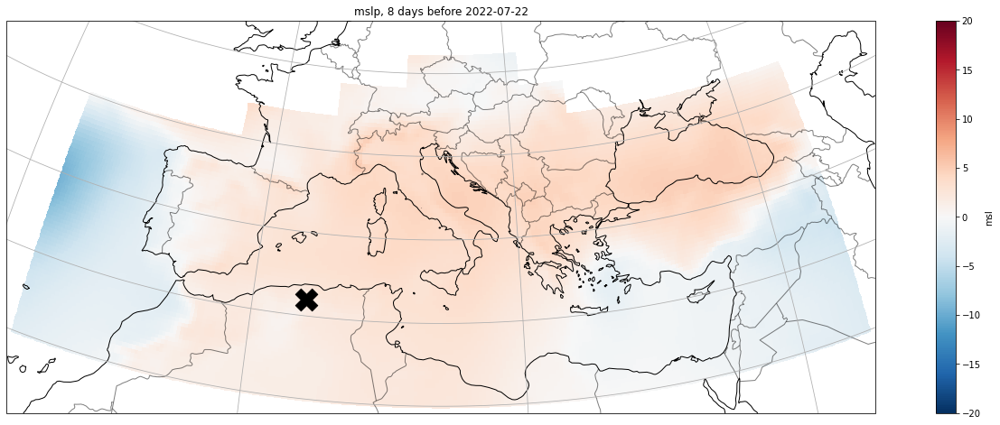

In [56]:
clint.set_maps_lag (xrdf = maskedmslp2022, targetdate_ts = date2022_ts, drivers_row = drivers_row, 
              fig_width = 24,
              proj = 'Orthographic')

#### Series of cluster centre

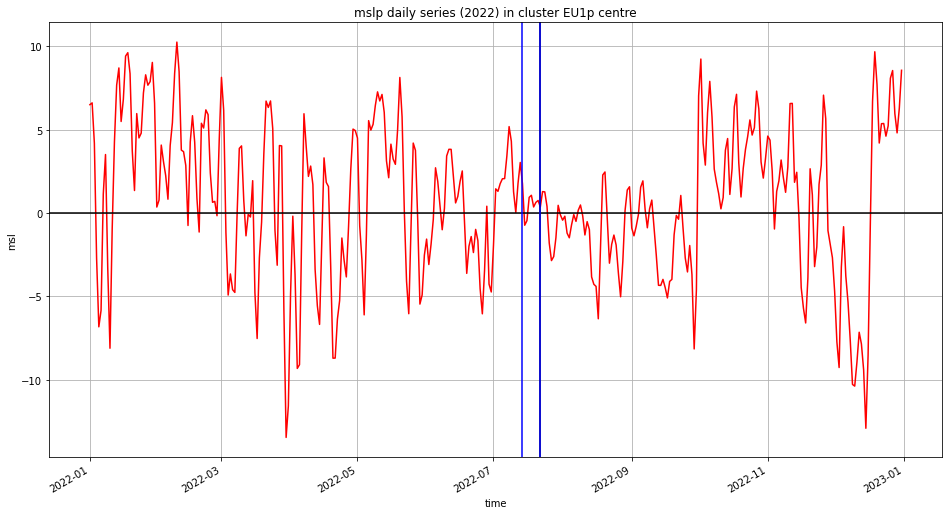

In [57]:
clint.daily_series_w_lags(mslp2022, drivers_row, date2022_ts, plotdir)

In [58]:
drivers

,var,nc_var,test_nr,cluster,cluster_info,minlag,maxlag,cluster_centre_lon,cluster_centre_lat,cl_ortho_lon,...,cl_ext_W,cl_ext_E,cl_ext_S,cl_ext_N,clmask_test3,cl_nr,vmin,vmax,empty,meanlag
0,tmax,mx2t,3,EU1t,Central Europe,0,16,14.0,54.0,14.0,...,-2.0,30.0,38.0,60.0,labels7t2mEurope5.csv,1,-10.0,10.0,NaN,8
1,tmax,mx2t,3,EU2t,North Atlantic,30,41,-6.0,42.0,0.0,...,-18.0,18.0,28.0,72.0,labels7t2mEurope5.csv,2,-10.0,10.0,NaN,35
2,mslp,msl,3,EU1p,Mediterranean,0,8,4.0,36.0,14.0,...,-16.0,44.0,25.0,50.0,labels1mslpEurope5.csv,1,-20.0,20.0,NaN,4
3,mslp,msl,3,EU2p,Eastern Europe,70,86,32.0,54.0,29.0,...,12.0,46.0,44.0,63.0,labels1mslpEurope5.csv,2,-20.0,20.0,NaN,78
4,mslp,msl,3,WO2p,Greenland,40,61,-78.0,80.0,-56.0,...,-85.0,-20.0,48.0,90.0,labels2mslpWorld5.csv,2,-20.0,20.0,NaN,50
5,sm,sm,3,EU1sm,Eastern Europe,0,26,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,13
6,sic,sic,3,AC1sic,North Atlantic and North Pacific,30,51,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,40


### 2022, mslp. Eastern Europe 70 to 86 days before 

In [59]:
### Eastern Europe 70 to 86 days before

drivers_row = drivers_sub.iloc[1]


#### Maps

In [60]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedmslp2022 = clint.mask_xr_w_df(mslp2022, submask)

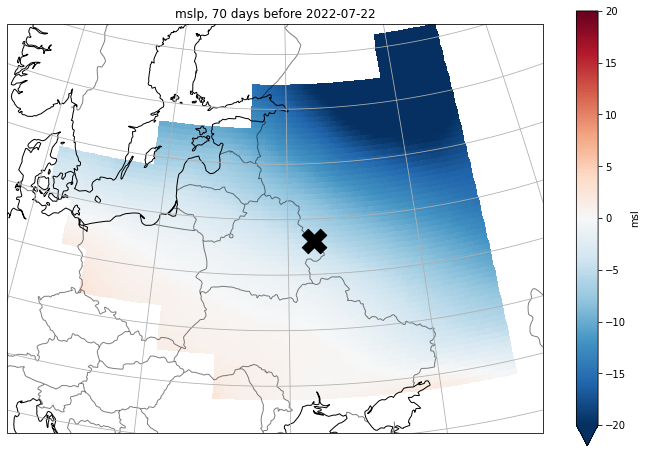

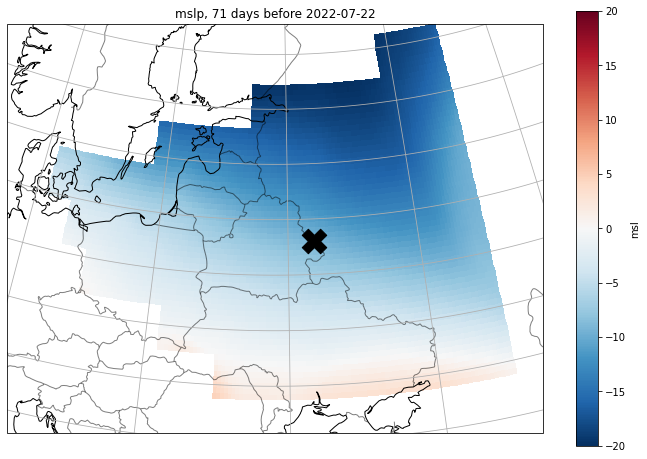

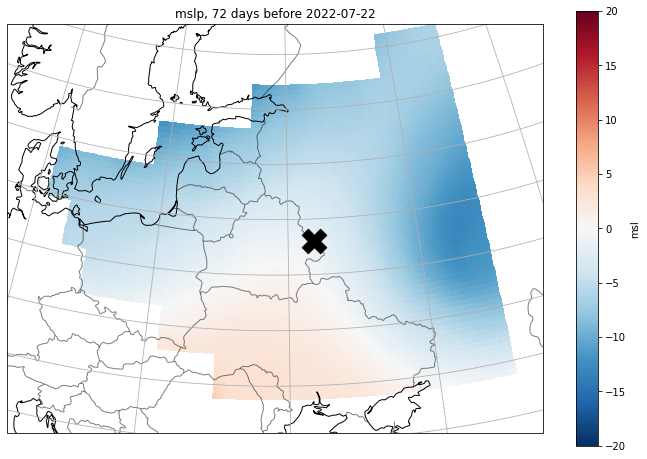

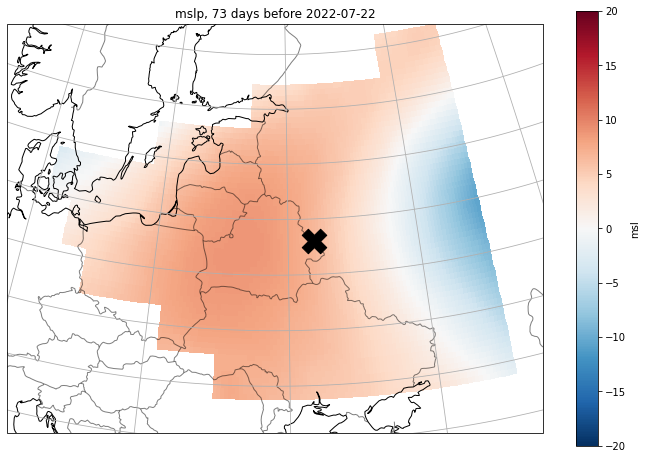

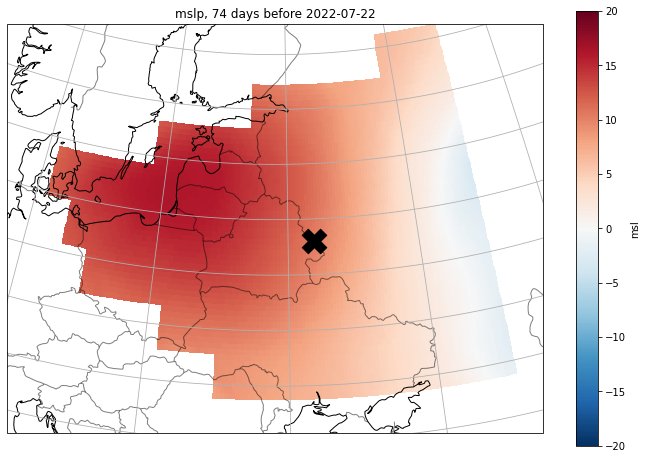

...

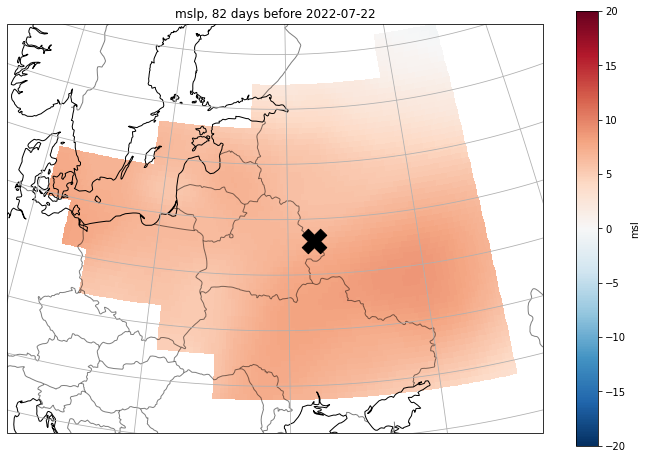

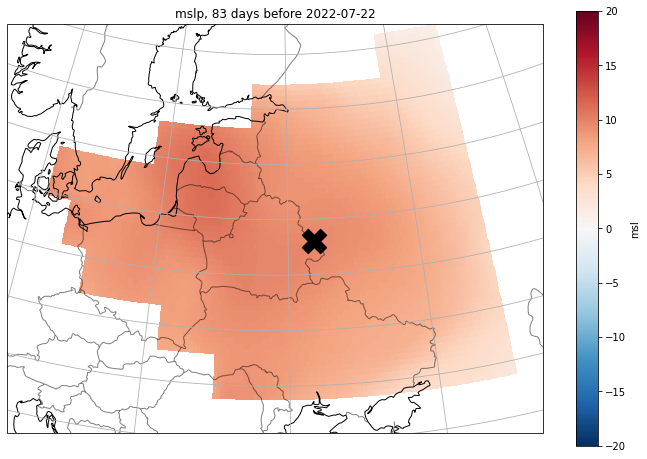

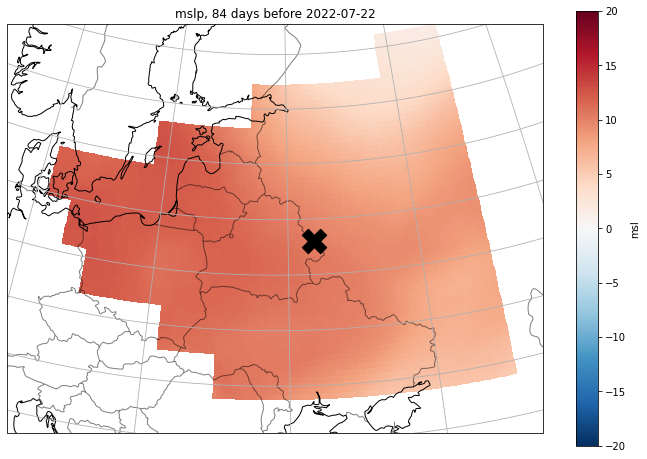

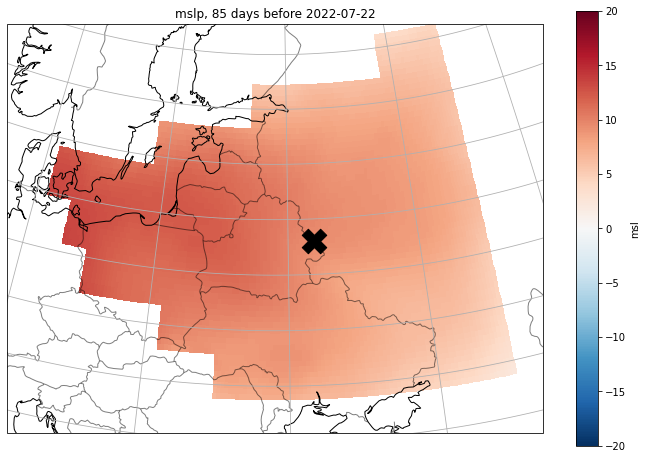

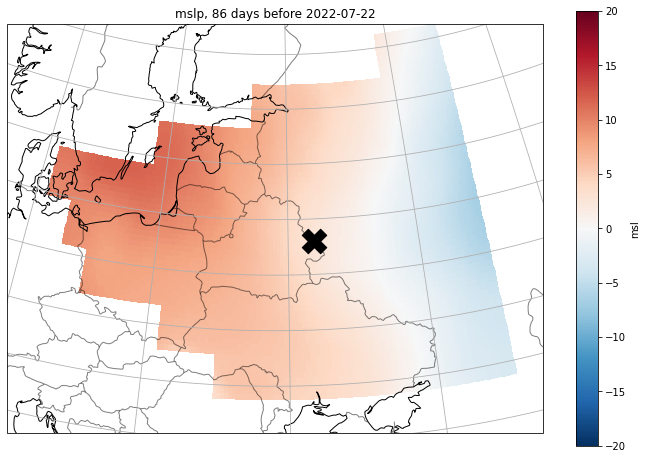

In [61]:
clint.set_maps_lag (xrdf = maskedmslp2022, targetdate_ts = date2022_ts, drivers_row = drivers_row, fig_width=12,
              proj = 'Orthographic')

#### Series of cluster centre

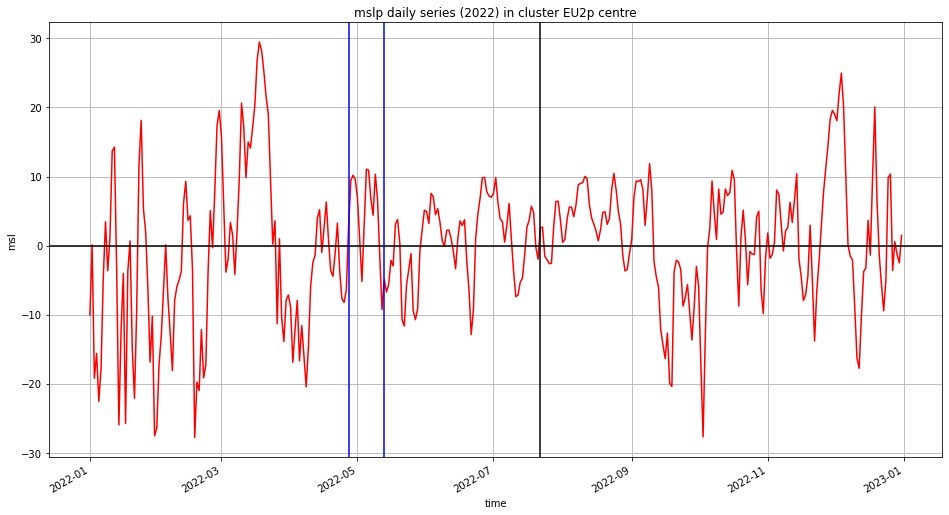

In [62]:
clint.daily_series_w_lags(mslp2022, drivers_row, date2022_ts, plotdir)

### 2022, mslp. Greenland 40 to 60 days before 

In [63]:
### Greenland 40 to 60 days before

drivers_row = drivers_sub.iloc[2]


In [64]:
drivers_row

var                                    mslp
nc_var                                  msl
test_nr                                   3
cluster                                WO2p
cluster_info                      Greenland
minlag                                   40
maxlag                                   61
cluster_centre_lon                    -78.0
cluster_centre_lat                     80.0
cl_ortho_lon                          -56.0
cl_ortho_lat                           72.0
cl_ext_W                              -85.0
cl_ext_E                              -20.0
cl_ext_S                               48.0
cl_ext_N                               90.0
clmask_test3          labels2mslpWorld5.csv
cl_nr                                     2
vmin                                  -20.0
vmax                                   20.0
empty                                   NaN
meanlag                                  50
Name: 4, dtype: object

In [65]:
## Read mask file and apply it

mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
cl_nr = drivers_row['cl_nr']
submask = mask_df[mask_df.cluster == cl_nr]
maskedmslp2022 = clint.mask_xr_w_df(mslp2022, submask)

#### Maps

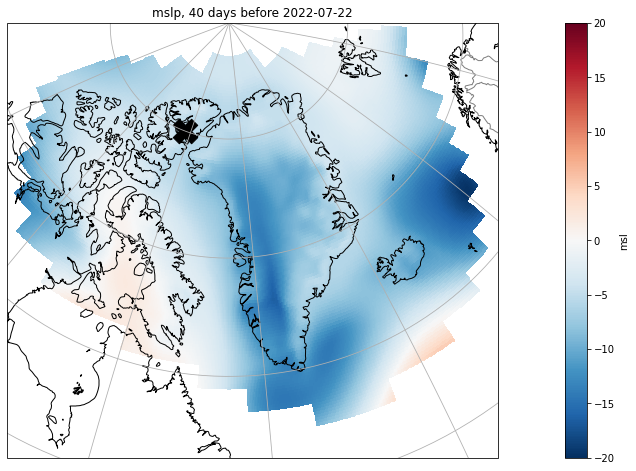

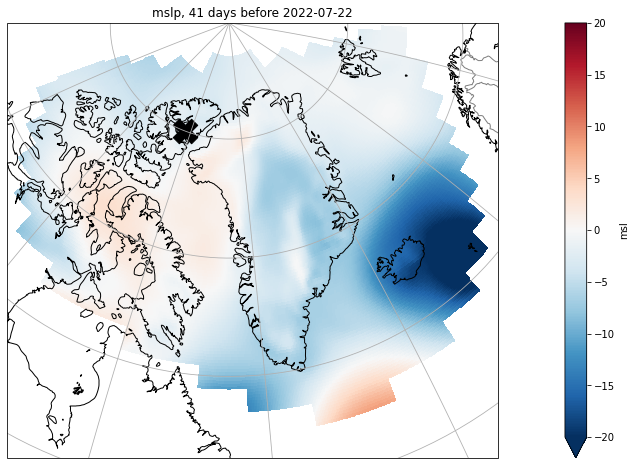

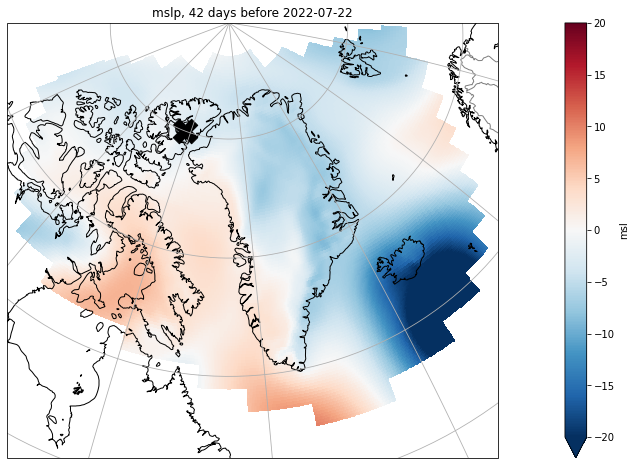

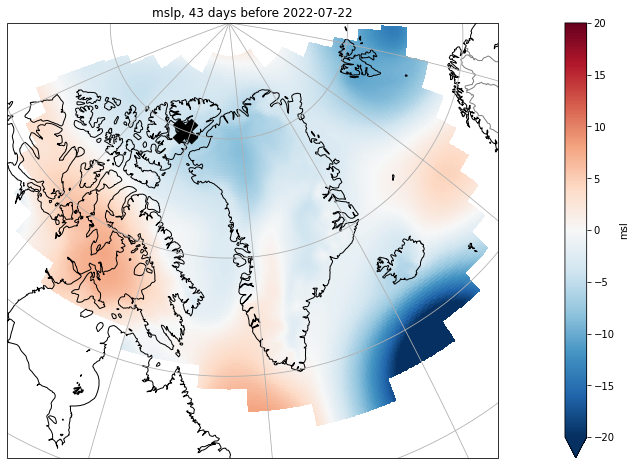

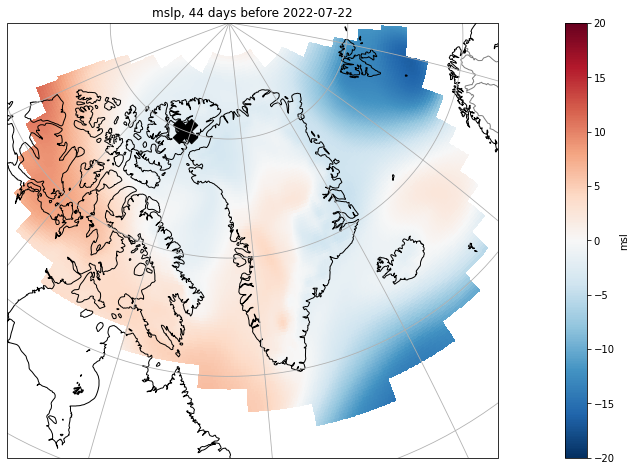

...

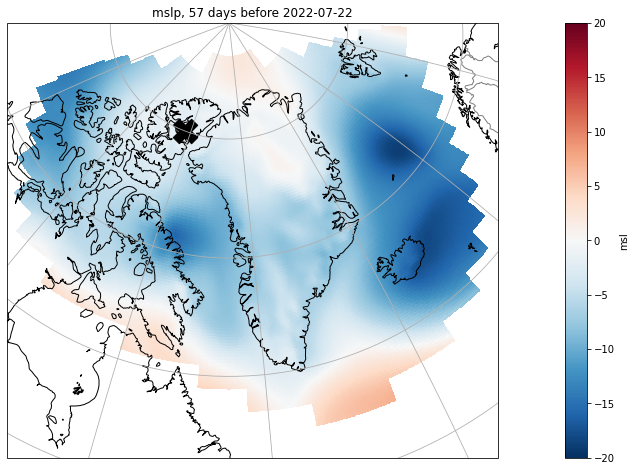

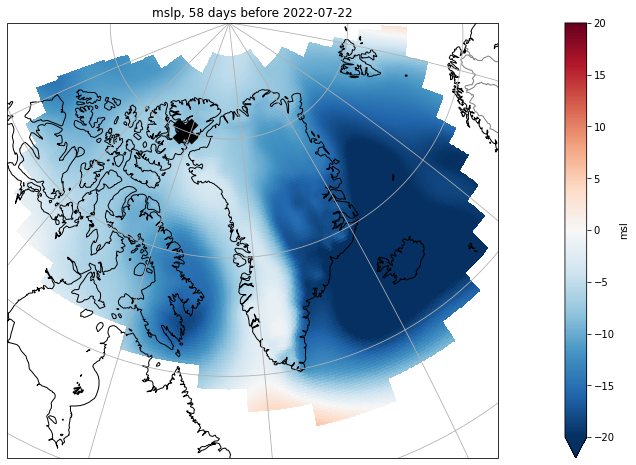

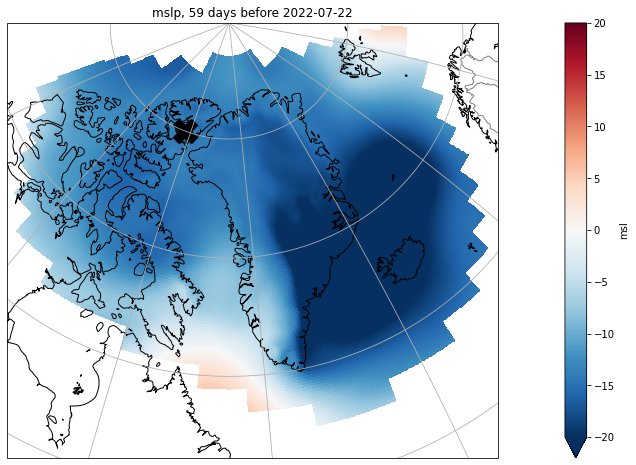

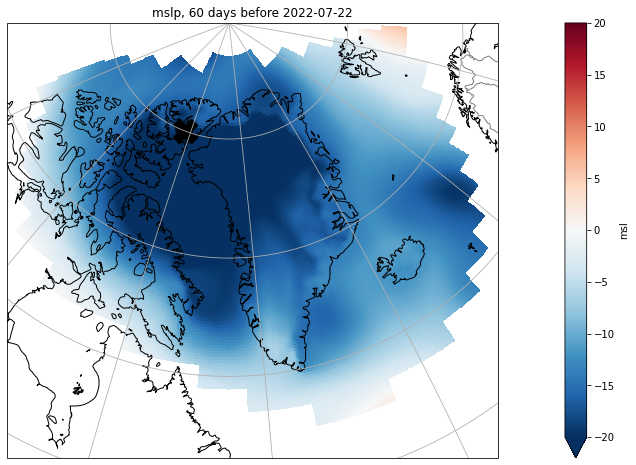

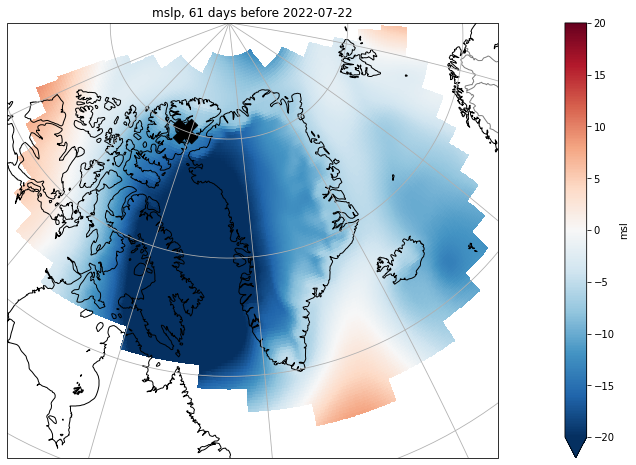

In [66]:
clint.set_maps_lag (xrdf = maskedmslp2022, targetdate_ts = date2022_ts, drivers_row = drivers_row,
              fig_width = 24,
              proj = 'Orthographic')

In [67]:
# minlag = int(drivers_row['minlag'])
# maxlag = int(drivers_row['maxlag'])
# # Determine extremes of the date range considered, in the netcdf every day has 12:00 as hour
# mintime_ts = targetdate_ts - pd.DateOffset(days = maxlag) + pd.DateOffset(hours = 12)
# maxtime_ts = targetdate_ts - pd.DateOffset(days = minlag) + pd.DateOffset(hours = 12)

# plt.rcParams['figure.figsize'] = [18,6]
# ax = plt.axes(projection=ccrs.LambertConformal(-40,45))
# ax.set_global()

# mslp2019.sel(time=mintime_ts).msl.plot(ax=ax, transform=ccrs.PlateCarree())
# ax.coastlines()
# ax.set_extent([-130, 45,1, 90])

#### Series of cluster centre

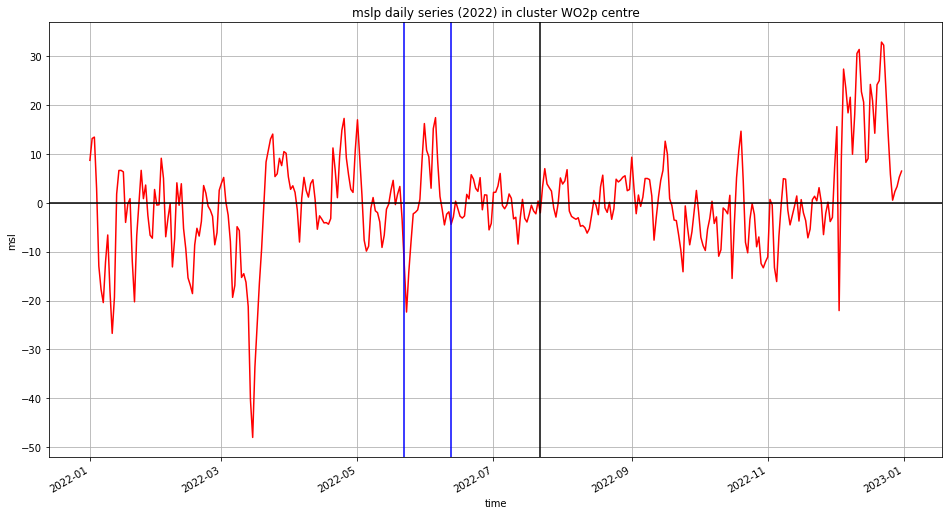

In [70]:
clint.daily_series_w_lags(mslp2022, drivers_row, date2022_ts, plotdir)

In [69]:
# map_proj = ccrs.LambertConformal(central_longitude=15, central_latitude=45)
# p = sub1d.mx2t.plot(
#     transform=ccrs.PlateCarree(),  # the data's projection
#     col="time",
#     col_wrap=1,  # multiplot settings
#     aspect=sub1d.longitude / sub1d.latitude,  # for a sensible figsize
#     subplot_kws={"projection": map_proj},
# )  # the plot's projection

# # We have to set the map's options on all axes
# for ax in p.axes.flat:
#     ax.coastlines()
#     ax.set_extent([-130, -45, 30, 90])